In [ ]:
# various import statements
import os
import inspect
import seaborn
import matplotlib
import matplotlib.pyplot as plt
import torch
import scanpy as sc
import pyro
import sys

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

if torch.cuda.is_available():
    print("GPU is available")
    print("Number of GPUs:", torch.cuda.device_count())
    print("GPU Name:", torch.cuda.get_device_name(0))
else:
    print("GPU is not available")

sc.settings.figdir='/home/matthew.schmitz/WbFigures/DevModelAnalysis/'

sys.path.append('/home/matthew.schmitz/utils/mts-utils/')
from genomics import sc_analysis

sys.path.append('/home/matthew.schmitz/Matthew/code/scANTIPODE/')
import antipode
from antipode.antipode_model import *
import antipode.model_functions
from antipode.model_functions import *
import antipode.model_distributions
from antipode.model_distributions import *
import antipode.model_modules
from antipode.model_modules import *
import antipode.train_utils
from antipode.train_utils import *
import antipode.plotting
from antipode.plotting import *

In [2]:
adata=sc.read_h5ad('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/models/1.9.1.8_extralevel/p2_adata.h5ad',backed='r')

KeyError: 'Unable to synchronously open object (address of object past end of allocation)'

In [ ]:
MDE_KEY='X_antipode_MDE'
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['q_score','species','dataset'],palette=sc.pl.palettes.godsnot_102,cmap='coolwarm'
)

In [2]:
adata=sc.read_h5ad('/home/matthew.schmitz/Matthew/data/taxtest/HvQvM/other_integrations/HvQvM_900k_RPCA_clusters.h5ad',backed='r')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

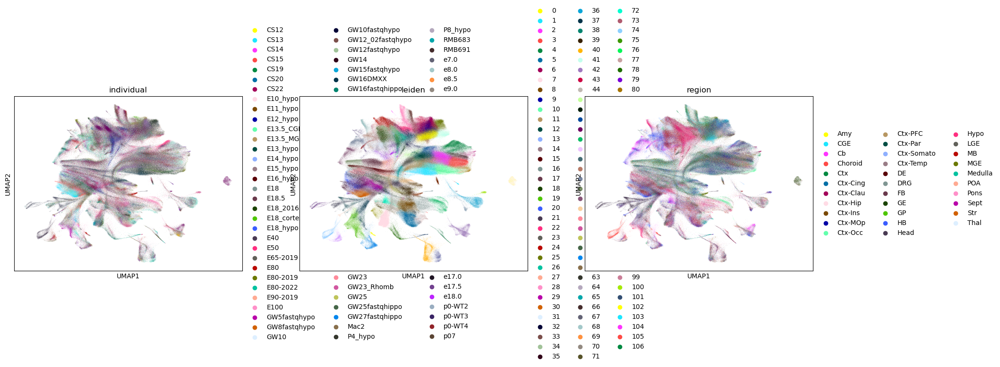

In [3]:
sc.pl.umap(adata,color=['individual','leiden','region'])

In [4]:
#adata.obs.groupby('batch_name')['individual'].value_counts().unstack().idxmax(1).to_csv('/home/matthew.schmitz/Matthew/data/taxtest/HvQvM/batch_individual.txt')

In [5]:
adata.obs

,latent_cell_probability,latent_RT_efficiency,n_genes,batch_name,dataset_name,timepoint,region,batch,clean_cellname,full_cellname,...,species,file_name,demux_type,assignment,species_batch,percent_ribo,percent_mito,leiden,individual,n_counts
TAGGGACTGGTACT_e18.0_ForebrainVentroLateral_SRR11947657,0.999821,1.315948,1773,e18.0_ForebrainVentroLateral_SRR11947657,PRJNA637987_lamanno_devmouse,18,FB,119,TAGGGACTGGTACT,TAGGGACTGGTACT_e18.0_ForebrainVentroLateral_SR...,...,mouse,NaN,NaN,NaN,0,0.092805,0.0,3,e18.0,2651.0
TAGTGGTGATCGAC_e8.0_Head_SRR11947592,0.999975,1.244477,4034,e8.0_Head_SRR11947592,PRJNA637987_lamanno_devmouse,8,Head,80,TAGTGGTGATCGAC,TAGTGGTGATCGAC_e8.0_Head_SRR11947592,...,mouse,NaN,NaN,NaN,0,0.214089,0.0,19,e8.0,16411.0
CGTACCTGCAGATC_e15.0_Hindbrain_SRR11947621,0.999861,0.968677,1524,e15.0_Hindbrain_SRR11947621,PRJNA637987_lamanno_devmouse,15,HB,54,CGTACCTGCAGATC,CGTACCTGCAGATC_e15.0_Hindbrain_SRR11947621,...,mouse,NaN,NaN,NaN,0,0.064366,0.0,26,e15.0,1944.0
GTACTTTCATACGCCG_E18_hypothalamus_SAMN11975086,0.999811,1.255550,1191,E18_hypothalamus_SAMN11975086,PRJNA547712_dev_hypothalamus,18,Hypo,133,GTACTTTCATACGCCG,GTACTTTCATACGCCG_E18_hypothalamus_SAMN11975086,...,mouse,NaN,NaN,NaN,0,0.075145,0.0,26,E18_hypo,1350.0
CTTCTCTTCGTGGTCG_E13_hypothalamus_SAMN11975092,0.999262,0.832245,1091,E13_hypothalamus_SAMN11975092,PRJNA547712_dev_hypothalamus,13,Hypo,128,CTTCTCTTCGTGGTCG,CTTCTCTTCGTGGTCG_E13_hypothalamus_SAMN11975092,...,mouse,NaN,NaN,NaN,0,0.070826,0.0,9,E13_hypo,1264.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
GTGCAGCGTCACCTAA_GW10_hypothalamus_kOut,0.999890,1.426240,1856,GW10_hypothalamus_kOut,NaN,56,Hypo,41,GTGCAGCGTCACCTAA,GTGCAGCGTCACCTAA_GW10_hypothalamus_kOut,...,human,NaN,NaN,NaN,2,0.055695,0.0,22,GW10,2152.0
CAACAACGTCAGGCAA_GW16_TemporalVZ_0_1_HNJJMDMXX_kOut,0.999420,1.044227,758,GW16_TemporalVZ_0_1_HNJJMDMXX_kOut,NaN,98,Ctx-Temp,139,CAACAACGTCAGGCAA,CAACAACGTCAGGCAA_GW16_TemporalVZ_0_1_HNJJMDMXX...,...,human,NaN,NaN,NaN,2,0.289206,0.0,25,GW16DMXX,1067.0
TTCCCAGGTAGTGAAT_GW18_V1_kOut,0.999666,0.767591,1298,GW18_V1_kOut,NaN,112,Ctx-Occ,91,TTCCCAGGTAGTGAAT,TTCCCAGGTAGTGAAT_GW18_V1_kOut,...,human,NaN,NaN,NaN,2,0.224631,0.0,3,GW18,1697.0
TGCGATATCCTTATCA_GW18_2_motorVZ_kOut,0.999828,0.927352,1655,GW18_2_motorVZ_kOut,NaN,112,Ctx-MOp,65,TGCGATATCCTTATCA,TGCGATATCCTTATCA_GW18_2_motorVZ_kOut,...,human,NaN,NaN,NaN,2,0.074031,0.0,6,GW18_2,1782.0


In [6]:
annots=pd.read_csv('/home/matthew.schmitz/Matthew/data/taxtest/HvQvM/rpca_annotations.txt',header=0,sep='\t',index_col=0)

In [8]:
annots

,0_CGE_NR2F2/PROX1_n,0_CGE_NR2F2/PROX1_s,1_1_n,1_1_s,2_2_n,2_2_s,3_3_n,3_3_s,4_4_n,4_4_s,...,102_102_s,103_103_n,103_103_s,104_104_n,104_104_s,105_105_n,105_105_s,106_106_n,106_106_s,Unnamed: 215
Automated Classification,Neuron,Neuron,Intermediate Progenitor Cell,Intermediate Progenitor Cell,Neuron,Neuron,Neuron,Neuron,Neuron,Neuron,...,Fibroblast,Neuron,Neuron,Proliferating Cell,Proliferating Cell,Pericyte,Pericyte,Intermediate Progenitor Cell,Intermediate Progenitor Cell,NaN
Top Regions,"['FB', 'LGE', 'Ctx-PFC', 'Ctx-Hip', 'CGE'],","['FB', 'LGE', 'Ctx-PFC', 'Ctx-Hip', 'CGE'],","['Ctx-Somato', 'Ctx-Par', 'Ctx-PFC', 'Ctx-Temp...","['Ctx-Somato', 'Ctx-Par', 'Ctx-PFC', 'Ctx-Temp...","['Ctx-Par', 'Ctx-Somato', 'Ctx-Ins', 'Ctx-Occ'...","['Ctx-Par', 'Ctx-Somato', 'Ctx-Ins', 'Ctx-Occ'...","['Ctx-Temp', 'Ctx-Par', 'Choroid', 'FB', 'Ctx-...","['Ctx-Temp', 'Ctx-Par', 'Choroid', 'FB', 'Ctx-...","['Ctx-Occ', 'Ctx-PFC', 'Ctx-Somato', 'FB', 'Ct...","['Ctx-Occ', 'Ctx-PFC', 'Ctx-Somato', 'FB', 'Ct...",...,"['HB', 'Ctx-MOp', 'Ctx-PFC', 'Head', 'Choroid'],","['CGE', 'FB', 'Head', 'Str', 'Thal'],","['CGE', 'FB', 'Head', 'Str', 'Thal'],","['Cb', 'CGE', 'Str', 'Thal', 'Ctx'],","['Cb', 'CGE', 'Str', 'Thal', 'Ctx'],","['Ctx-PFC', 'Ctx-Par', 'Thal', 'HB', 'Hypo'],","['Ctx-PFC', 'Ctx-Par', 'Thal', 'HB', 'Hypo'],","['Thal', 'Ctx-Somato', 'Ctx-Par', 'Ctx-MOp', '...","['Thal', 'Ctx-Somato', 'Ctx-Par', 'Ctx-MOp', '...",NaN
class_region_markers style name,N_CGE_NR2F2/PROX1,NaN,IPC_CTX_UL,NaN,N_CTX_UL,NaN,N_CTX_UL,NaN,NaN,N_CTX_DL,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
MTS Notes,NaN,NaN,Excitator upper layer ipc,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Alex Notes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Reed Notes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,Thalamus? GBX2 and TCF7L2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Sara Notes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


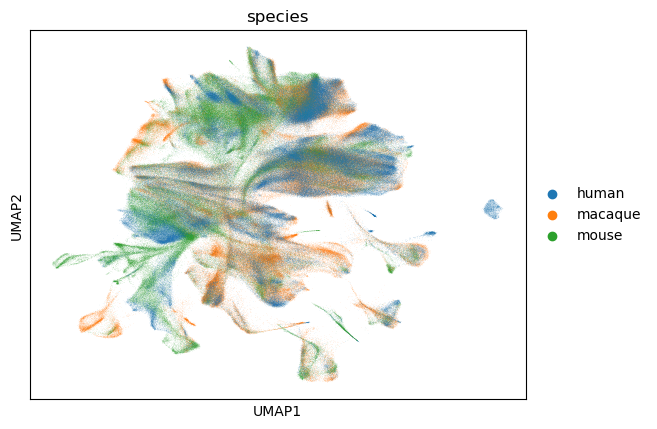

In [30]:
sc.pl.umap(adata,color=['species'])

In [22]:
leiden_col=[x.split('_')[0] for x in annots.columns]
classification=annots.loc['Automated Classification',:]
leiden_class_d=dict(zip(leiden_col,classification))

In [45]:
leiden_class_d['15']='Proliferating Cell'
leiden_class_d['53']='Neuron'
leiden_class_d['64']='Neuron'
leiden_class_d['79']='Neuron'
leiden_class_d['93']='Neuron'
leiden_class_d['104']='Neuron?'
leiden_class_d['96']='Fibroblast?'
leiden_class_d['81']='Pericyte?'

In [46]:
adata.obs['class']=adata.obs['leiden'].replace(leiden_class_d)

/scratch/fast/15542662/ipykernel_32617/103880700.py:1: FutureWarning: The behavior of Series.replace (and DataFrame.replace) with CategoricalDtype is deprecated. In a future version, replace will only be used for cases that preserve the categories. To change the categories, use ser.cat.rename_categories instead.
  adata.obs['class']=adata.obs['leiden'].replace(leiden_class_d)


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


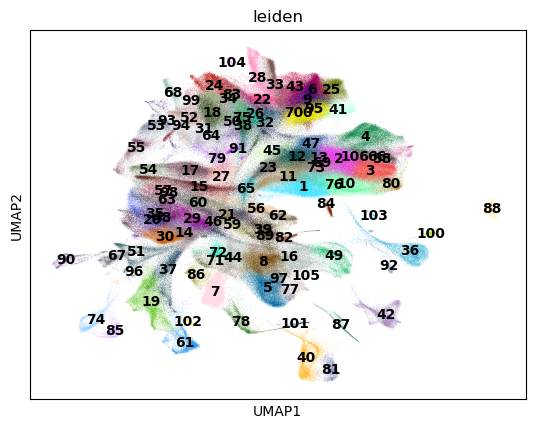

In [47]:
sc.pl.umap(adata,color=['leiden'],legend_loc='on data')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


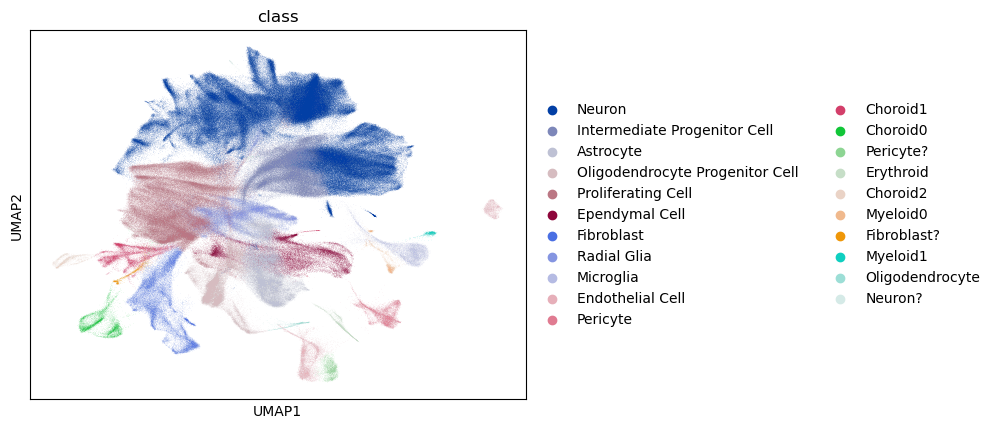

In [48]:
sc.pl.umap(adata,color=['class'])

In [49]:
adata.obs.columns

Index(['latent_cell_probability', 'latent_RT_efficiency', 'n_genes',
       'batch_name', 'dataset_name', 'timepoint', 'region', 'batch',
       'clean_cellname', 'full_cellname', 'msregion', 'general_region',
       'species', 'file_name', 'demux_type', 'assignment', 'species_batch',
       'percent_ribo', 'percent_mito', 'leiden', 'individual', 'n_counts',
       'class'],
      dtype='object')

In [52]:
adata.obs.loc[:,['class','leiden']].to_csv('/home/matthew.schmitz/Matthew/data/taxtest/HvQvM/other_integrations/rpca_cell_annotations.txt')

# Lead Model Param Analysis

In [2]:
adata=sc.read_h5ad('/home/matthew.schmitz/Matthew/1.9.1.6_DevTighterNoPsi.h5ad')

In [ ]:
pstore=adata.uns['param_store']

In [ ]:
adata.obs

In [5]:
discov_key='species'
batch_key='batch_name'
MDE_KEY = "X_antipode_MDE"

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


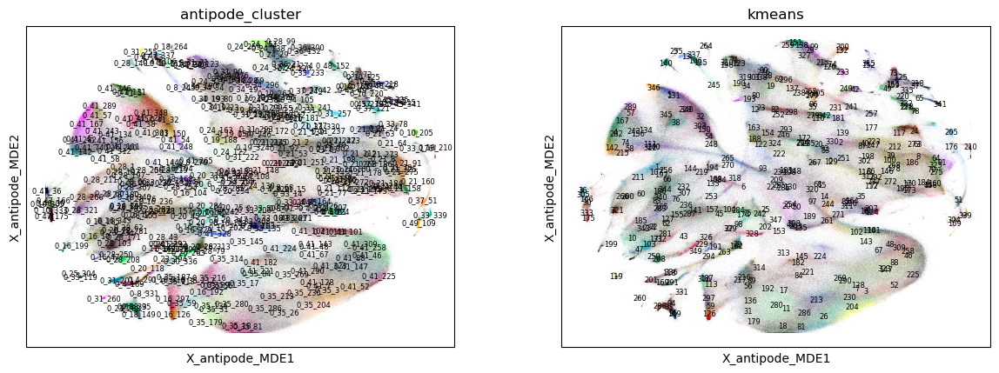

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value t

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:1234: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


In [5]:
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=["antipode_cluster","kmeans"],legend_fontsize=6,legend_fontweight='normal',
    legend_loc='on data',palette=sc.pl.palettes.godsnot_102
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=[x for x in adata.obs.columns if 'level' in x],
    palette=sc.pl.palettes.godsnot_102,
    legend_loc='on data'
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=[x for x in adata.obs.columns if 'psi' in x],
    cmap='coolwarm',
    legend_loc='on data'
)

sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['q_score',discov_key,batch_key],palette=sc.pl.palettes.godsnot_102,cmap='coolwarm'
)


ERROR! Session/line number was not unique in database. History logging moved to new session 598


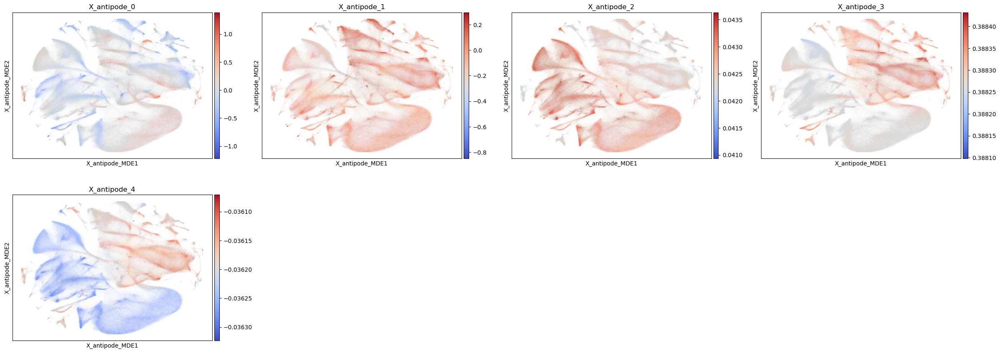

In [6]:
d=dict()
for i in range(adata.obsm['X_antipode'].shape[1]):
    d['X_antipode_'+str(i)]=adata.obsm['X_antipode'][:,i] 
adata.obs=pd.concat([adata.obs,pd.DataFrame(d,index=adata.obs.index)],axis=1)
sc.pl.embedding(
    adata,
    basis=MDE_KEY,
    color=['X_antipode_'+str(i) for i in range(5)],
    cmap='coolwarm')   

In [7]:
seaborn.histplot(adata.obs['psi_0'],stat='probability')
plt.show()
seaborn.histplot(adata.obs['psi_1'],stat='probability')
plt.show()
seaborn.histplot(adata.obs['psi_2'],stat='probability')
plt.show()

KeyError: 'psi_0'

In [10]:
psis=np.concatenate([adata.obs[x].to_numpy()[:,np.newaxis] for x in adata.obs.columns if 'psi_' in x],axis=1)
psis=torch.repeat_interleave(torch.tensor(psis),torch.tensor([1,50,350]),dim=-1)

ValueError: need at least one array to concatenate

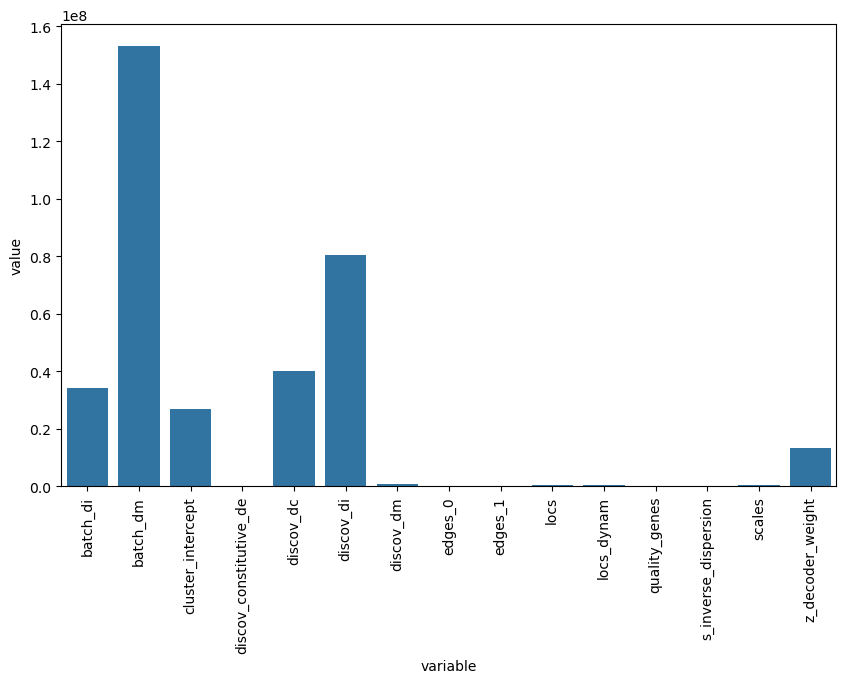

In [7]:
import sys
d={}
for k in adata.uns['param_store'].keys():
    d[k]=sys.getsizeof(adata.uns['param_store'][k])

df=pd.DataFrame(d.values())
df.index=d.keys()
df_melted = df.T.melt(value_vars=df.index)
# Plotting
plt.figure(figsize=(10, 6))  # Adjust the figure size to ensure labels don't overlap
seaborn.barplot(x='variable', y='value', data=df_melted)
plt.xticks(rotation=90)  # Rotate the labels if necessary
plt.show()


In [8]:
adata

AnnData object with n_obs × n_vars = 2355534 × 16738
    obs: 'n_genes', 'batch_name', 'dataset_name', 'timepoint', 'region', 'clean_cellname', 'full_cellname', 'msregion', 'general_region', 'species', 'percent_ribo', 'n_counts', 'log10_n_counts', 'individual', '_scvi_discov_ind', '_scvi_batch_ind', 'psi', 'q_score', 'level_0', 'level_1', 'level_2', 'antipode_cluster', 'kmeans', 'X_antipode_0', 'X_antipode_1', 'X_antipode_2', 'X_antipode_3', 'X_antipode_4', 'X_antipode_5', 'X_antipode_6', 'X_antipode_7', 'X_antipode_8', 'X_antipode_9', 'X_antipode_10', 'X_antipode_11', 'X_antipode_12', 'X_antipode_13', 'X_antipode_14', 'X_antipode_15', 'X_antipode_16', 'X_antipode_17', 'X_antipode_18', 'X_antipode_19', 'X_antipode_20', 'X_antipode_21', 'X_antipode_22', 'X_antipode_23', 'X_antipode_24', 'X_antipode_25', 'X_antipode_26', 'X_antipode_27', 'X_antipode_28', 'X_antipode_29', 'X_antipode_30', 'X_antipode_31', 'X_antipode_32', 'X_antipode_33', 'X_antipode_34', 'X_antipode_35', 'X_antipode_36',

In [9]:
"""
loc_dynams=0
loc_dynams=(adata.obsm['taxon_probs']*psis)@pstore['locs_dynam']
cluster_means=(((adata.obsm['taxon_probs']@pstore['locs']+loc_dynams)@pstore['z_decoder_weight'])+pstore['cluster_intercept'])
cluster_params=(np.sign(cluster_means)*0) + cluster_means
"""

"\nloc_dynams=0\nloc_dynams=(adata.obsm['taxon_probs']*psis)@pstore['locs_dynam']\ncluster_means=(((adata.obsm['taxon_probs']@pstore['locs']+loc_dynams)@pstore['z_decoder_weight'])+pstore['cluster_intercept'])\ncluster_params=(np.sign(cluster_means)*0) + cluster_means\n"

In [10]:
cluster_params=(pstore['locs']@pstore['z_decoder_weight'])+pstore['cluster_intercept']

In [11]:
coefs=[]
for i in tqdm.tqdm(range(cluster_params.shape[0])):
    others=list(set(list(range(cluster_params.shape[0])))-set([i]))
    coefs.append((cluster_params[i:(i+1),:]-cluster_params[others,:].mean(0))/(cluster_params.std(0)))
coefs=np.concatenate(coefs,axis=0)

100%|██████████| 401/401 [00:11<00:00, 35.62it/s]


In [ ]:
#sc.pl.dotplot(adata[:100000,:],groupby='level_2',var_names=pd.DataFrame(coefs.T,index=adata.var.index).idxmax(0),dendrogram=False,standard_scale='var',use_raw=False,cmap='coolwarm')
sc.pl.dotplot(adata,groupby='level_2',var_names=pd.DataFrame(coefs.T,index=adata.var.index).idxmax(0),dendrogram=False,standard_scale='var',use_raw=False,cmap='coolwarm')

In [12]:
adult_means=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/mouse_wb/AIT21.all.freeze.230815_subclassmeans.csv',index_col=0)

In [16]:
dev_outputs=antipode.plotting.group_aggr_anndata(adata,'antipode_cluster')
dev_meangenes=pd.DataFrame(dev_outputs[0],index=dev_outputs[1]['antipode_cluster'],columns=adata.var.index)
dev_meangenes.to_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/HvQvM/dev_meangenes.csv')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


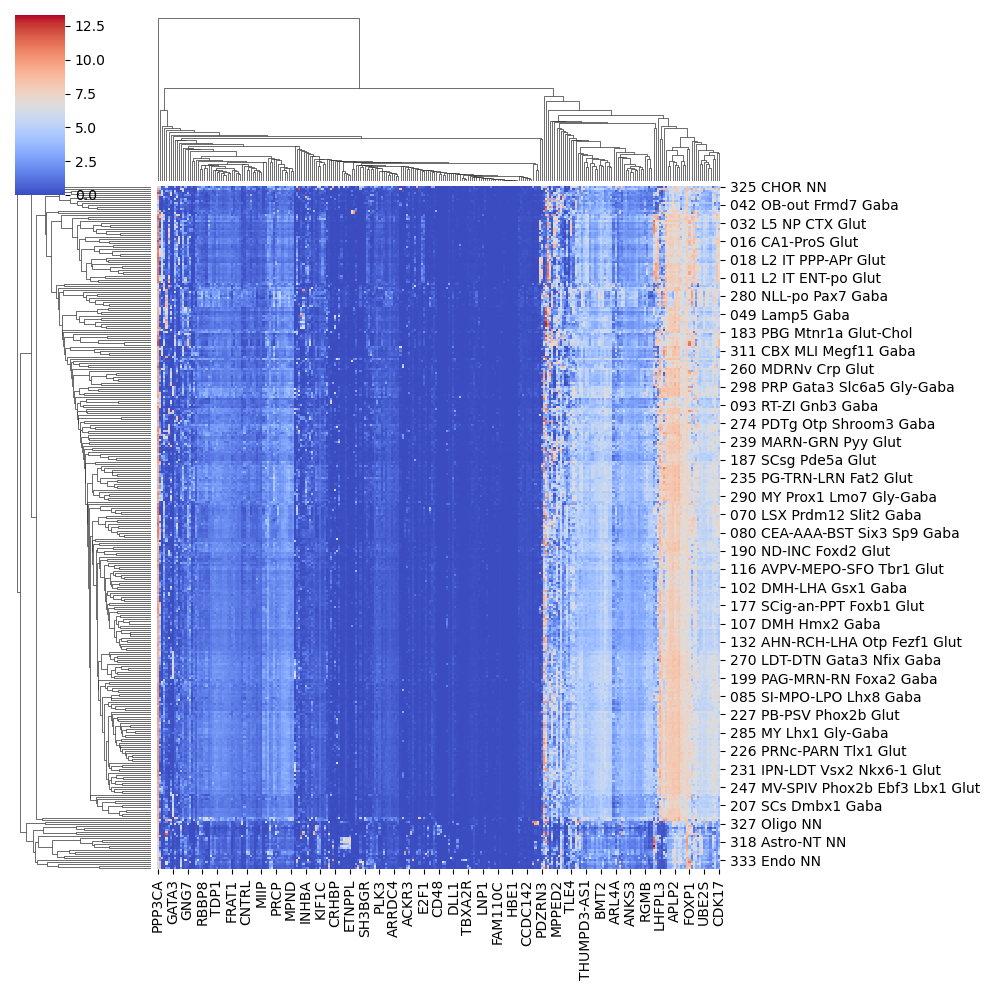

In [20]:
marker_genes=list(set(pd.DataFrame(coefs.T,index=adata.var.index).idxmax(0)))
marker_genes=[x for x in marker_genes if x in set(dev_meangenes.columns)&set(adult_means.columns)]
adult_markers=adult_means.loc[:,marker_genes]
seaborn.clustermap(adult_means.loc[:,marker_genes],cmap='coolwarm')

<Axes: xlabel='None', ylabel='None'>

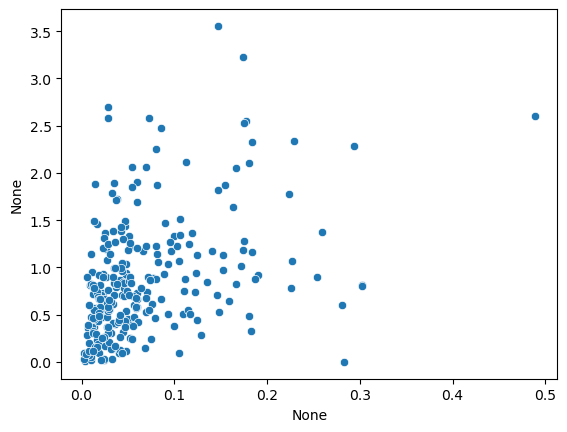

In [38]:
seaborn.scatterplot(x=dev_markers.std(0),y=adult_markers.std(0))

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


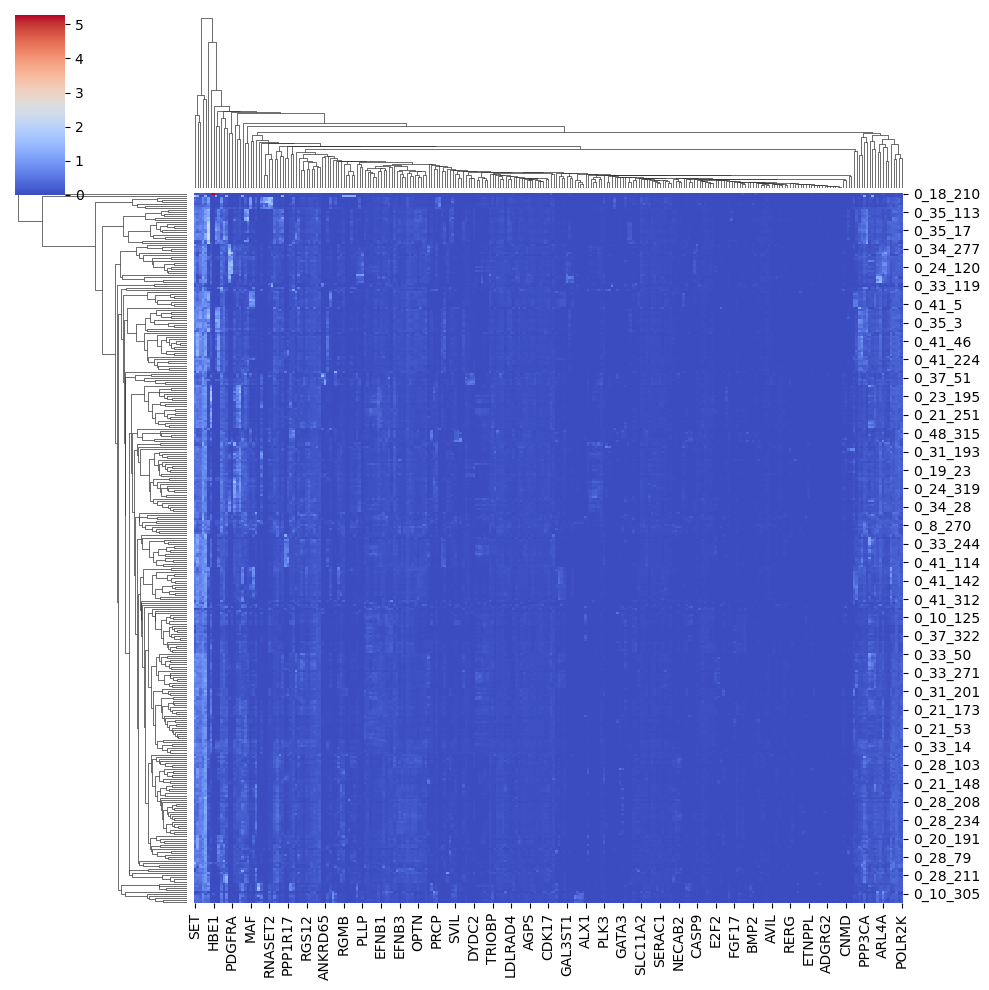

In [21]:
marker_genes=list(set(pd.DataFrame(coefs.T,index=adata.var.index).idxmax(0)))
marker_genes=[x for x in marker_genes if x in set(dev_meangenes.columns)&set(adult_means.columns)]
dev_markers=dev_meangenes.loc[:,marker_genes]
seaborn.clustermap(dev_markers,cmap='coolwarm')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


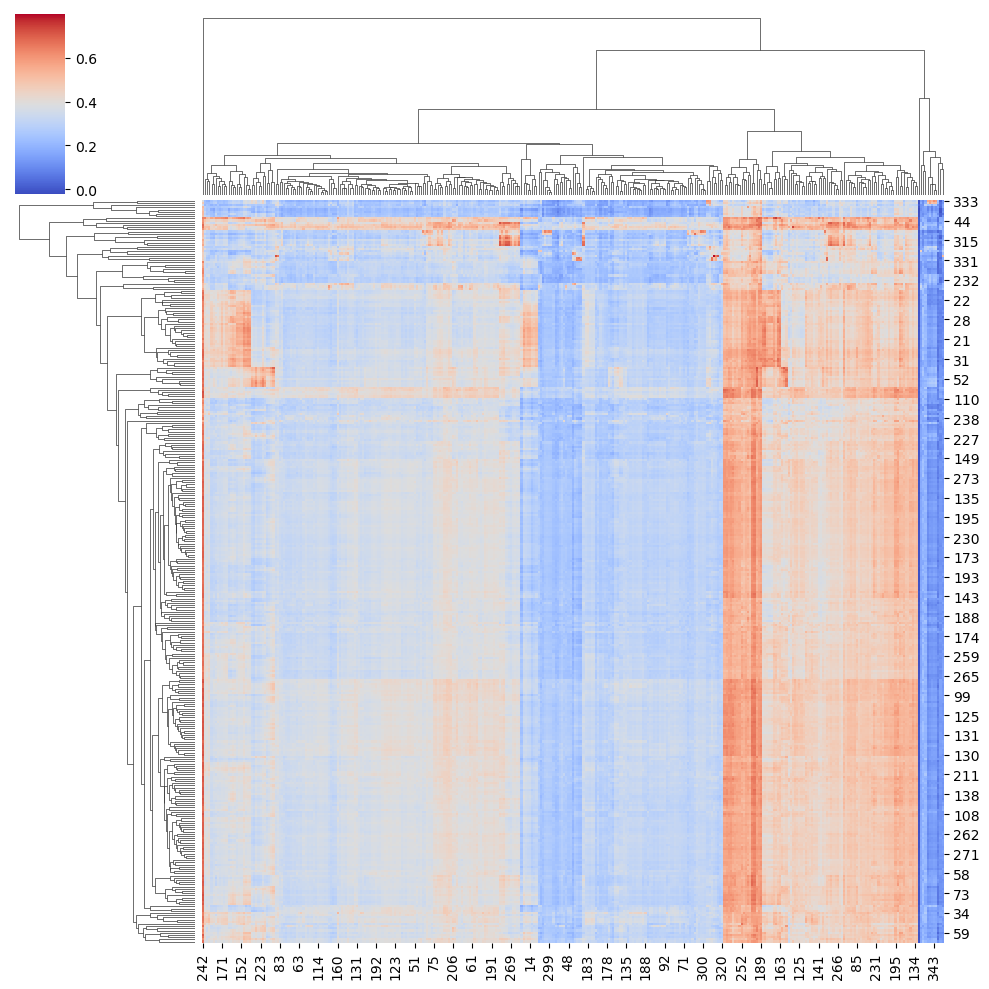

In [30]:
seaborn.clustermap(sc_analysis.maximize_diagonality(sc_analysis.corr2_coeff(adult_markers.to_numpy(),dev_markers.to_numpy()))[0],cmap='coolwarm')

In [16]:
#original
#sc.pl.umap(adata,color=set(pd.DataFrame(coefs.T,index=adata.var.index).idxmax(0)),use_raw=False,cmap='Purples')

In [19]:
from genomics.sc_analysis import corr2_coeff

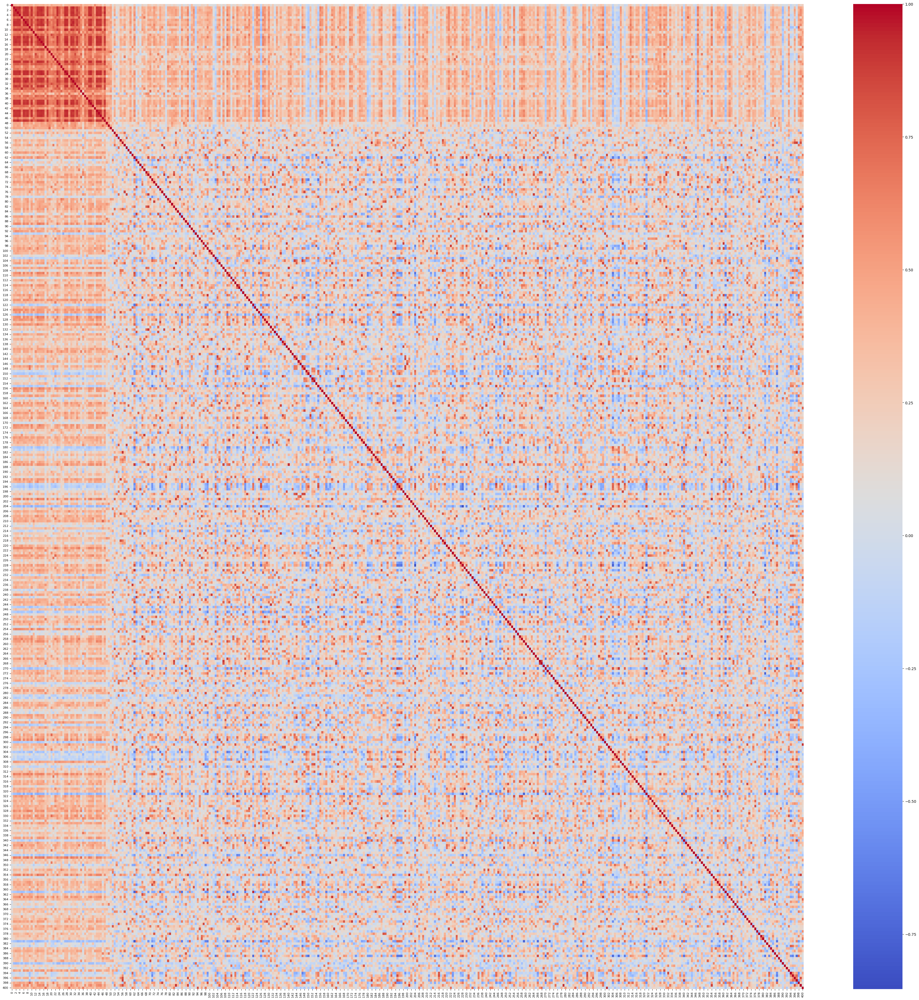

In [20]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['locs'],pstore['locs'])),cmap='coolwarm')

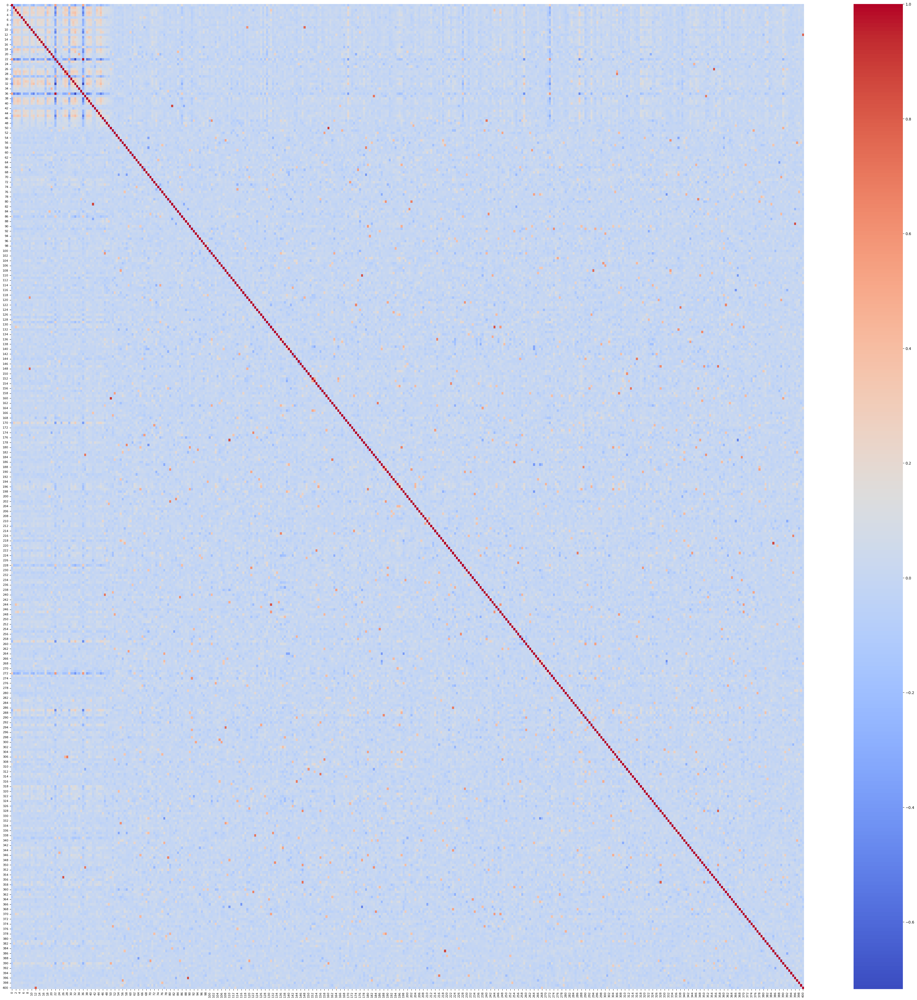

In [21]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['discov_di'][0],pstore['discov_di'][0])),cmap='coolwarm')

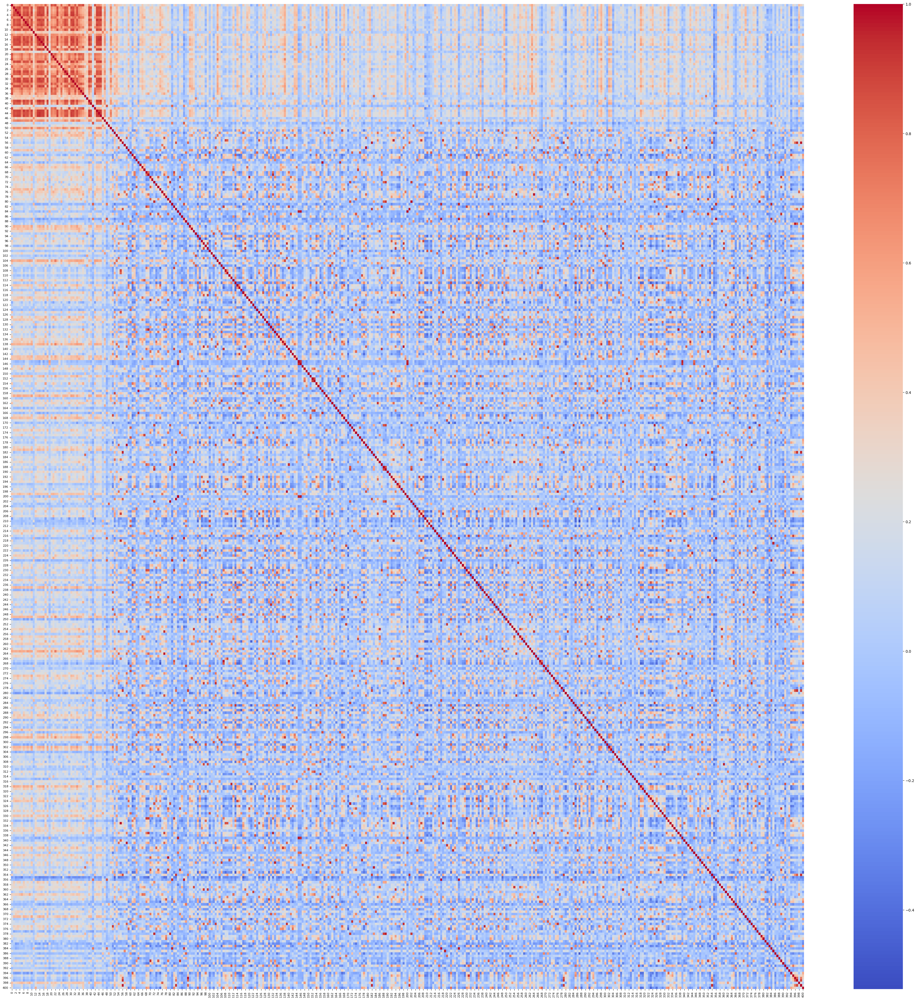

In [22]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['discov_dm'][0],pstore['discov_dm'][0])),cmap='coolwarm')

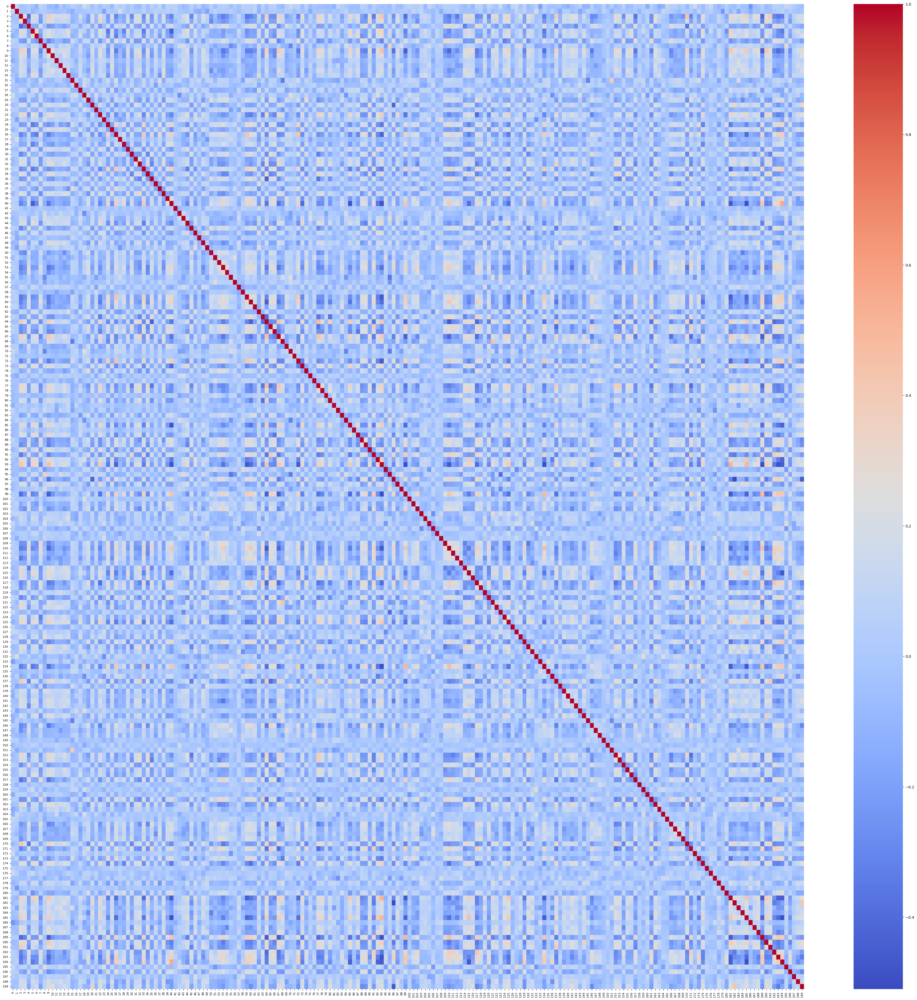

In [23]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['discov_dc'][0],pstore['discov_dc'][0])),cmap='coolwarm')

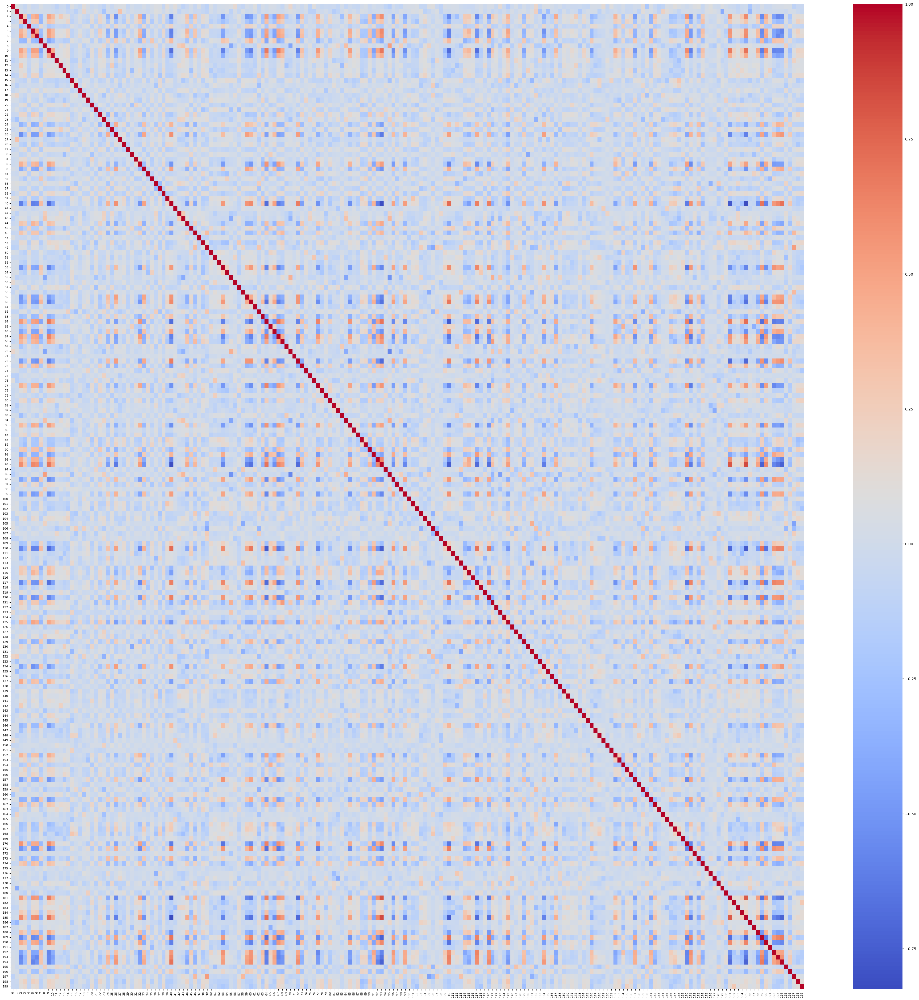

In [24]:
sc_analysis.create_heatmap(pd.DataFrame(sc_analysis.corr2_coeff(pstore['z_decoder_weight'],pstore['z_decoder_weight'])),cmap='coolwarm')

In [25]:
def gex_output(x,m,b):
    return((torch.softmax((x@m+b),-1)).log())

def gex_output(x,m,b):
    return((x@m+b))

In [26]:
loc_dynams=0
est_cluster_means=gex_output((pstore['locs']+loc_dynams),(pstore['z_decoder_weight']),pstore['cluster_intercept'])

In [27]:
cluster_species=[]
for species_ind in list(range(pstore['discov_di'].shape[0])):
    cluster_species.append(gex_output((pstore['locs']+loc_dynams+pstore['discov_dm'][species_ind]),
                                      (pstore['z_decoder_weight']+pstore['discov_dc'][species_ind]),
                                      pstore['discov_di'][species_ind]))
estimated_ge=np.stack(cluster_species)

In [28]:
"""
cluster_species=[]
df=pd.DataFrame(adata.X)
df['antipode_cluster']=list(adata.obs['antipode_cluster'].astype(int))
df['species']=list(adata.obs['species'])
df['antipode_cluster']=df['antipode_cluster'].astype('category')
X=df.groupby(['species','antipode_cluster']).mean()
for species_ind in tqdm.tqdm(adata.obs.species.cat.categories):
    cluster_species.append(X.loc[species_ind,:])
real_ge=np.stack(cluster_species)
"""

"\ncluster_species=[]\ndf=pd.DataFrame(adata.X)\ndf['antipode_cluster']=list(adata.obs['antipode_cluster'].astype(int))\ndf['species']=list(adata.obs['species'])\ndf['antipode_cluster']=df['antipode_cluster'].astype('category')\nX=df.groupby(['species','antipode_cluster']).mean()\nfor species_ind in tqdm.tqdm(adata.obs.species.cat.categories):\n    cluster_species.append(X.loc[species_ind,:])\nreal_ge=np.stack(cluster_species)\n"

In [29]:
cluster_species=[]
for species_ind in list(range(pstore['discov_di'].shape[0])):
    cluster_species.append(gex_output((pstore['locs']+loc_dynams),
                                      (pstore['z_decoder_weight']+pstore['discov_dc'][species_ind]),
                                      0))
cluster_species=np.stack(cluster_species)
dc_diffs=cluster_species

In [30]:
cluster_species=[]
for species_ind in list(range(pstore['discov_di'].shape[0])):
    cluster_species.append(gex_output((pstore['locs']+loc_dynams),
                                      (pstore['z_decoder_weight']),
                                      pstore['discov_di'][species_ind]))
de_diffs=np.stack(cluster_species)


In [31]:
cluster_species=[]
for species_ind in list(range(pstore['discov_di'].shape[0])):
    cluster_species.append(gex_output((pstore['locs']+loc_dynams+pstore['discov_dm'][species_ind]),
                                      (pstore['z_decoder_weight']),
                                      0))
dm_diffs=np.stack(cluster_species)


In [32]:
HoM=estimated_ge[0]-estimated_ge[2]

In [33]:
#gene DE in different celltypes
(HoM@HoM.T)

array([[ 7.5122681e+03,  4.0625220e+02,  2.7043372e+02, ...,
         1.1138611e+03,  6.8936609e+02,  1.1196803e+03],
       [ 4.0625220e+02,  5.6897903e+01,  2.2649858e+01, ...,
         9.7552734e+01, -1.6558683e+01,  3.5828180e+00],
       [ 2.7043372e+02,  2.2649858e+01,  5.7763573e+01, ...,
         3.0763834e+01, -3.2850475e+01, -8.7964119e+01],
       ...,
       [ 1.1138611e+03,  9.7552734e+01,  3.0763834e+01, ...,
         1.1872900e+03,  1.7169714e+02,  2.3869896e+02],
       [ 6.8936609e+02, -1.6558683e+01, -3.2850475e+01, ...,
         1.7169714e+02,  2.3487803e+03,  1.0248379e+03],
       [ 1.1196803e+03,  3.5828180e+00, -8.7964119e+01, ...,
         2.3869896e+02,  1.0248379e+03,  2.6818770e+03]], dtype=float32)

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 1.0, '# Divergent Genes Shared Across Clusters')

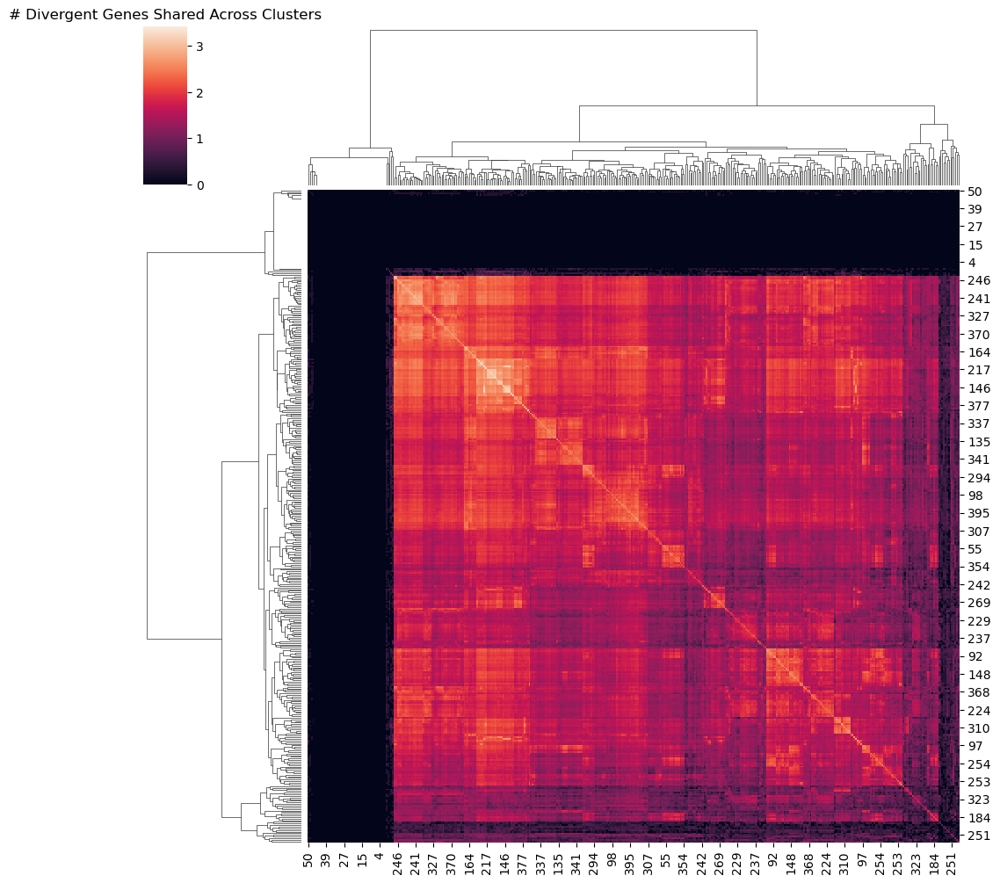

In [34]:
seaborn.clustermap(np.log10(((np.abs(HoM)>1).astype(np.float64)@(np.abs(HoM.T)>1).astype(np.float64) )+1))
plt.title('# Divergent Genes Shared Across Clusters')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 1.0, '# Divergent Genes Shared Across Clusters')

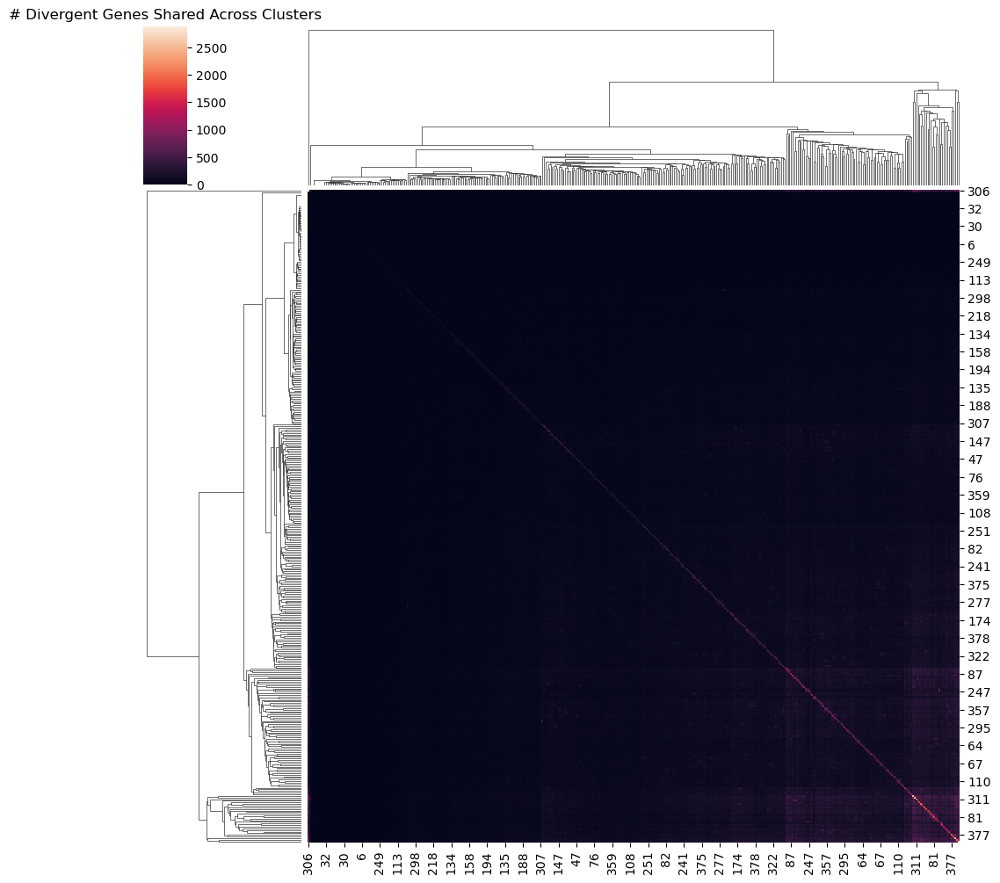

In [35]:
de_sub=de_diffs[0]-de_diffs[2]
seaborn.clustermap((de_sub>0.01).astype(np.float64)@(de_sub.T>0.01).astype(np.float64))
plt.title('# Divergent Genes Shared Across Clusters')


/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 1.0, '# DC Genes Shared Across Clusters')

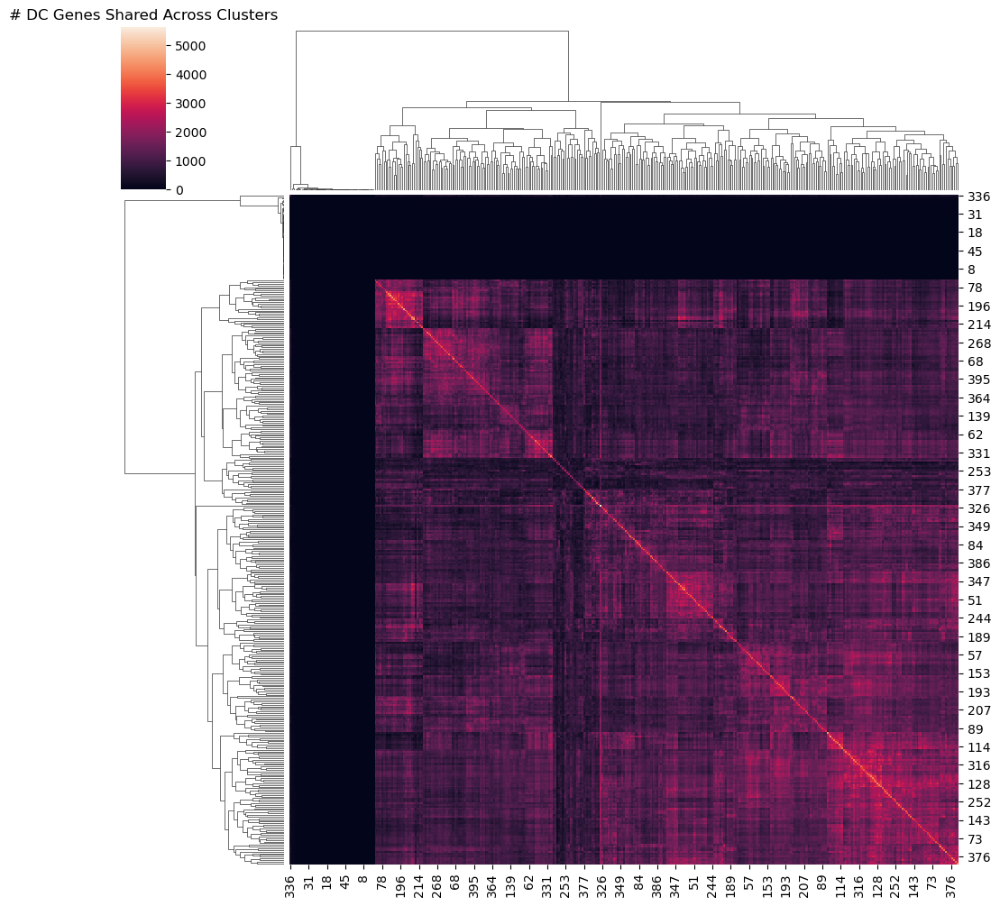

In [36]:
dc_sub=dc_diffs[0]-dc_diffs[2]
seaborn.clustermap((dc_sub>0.1).astype(np.float64)@(dc_sub.T>0.1).astype(np.float64))
plt.title('# DC Genes Shared Across Clusters')

/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)
/home/matthew.schmitz/Matthew/utils/miniforge3/envs/pyro/lib/python3.11/site-packages/seaborn/matrix.py:560: UserWarning: Clustering large matrix with scipy. Installing `fastcluster` may give better performance.
  warnings.warn(msg)


Text(0.5, 1.0, '# DM Genes Shared Across Clusters')

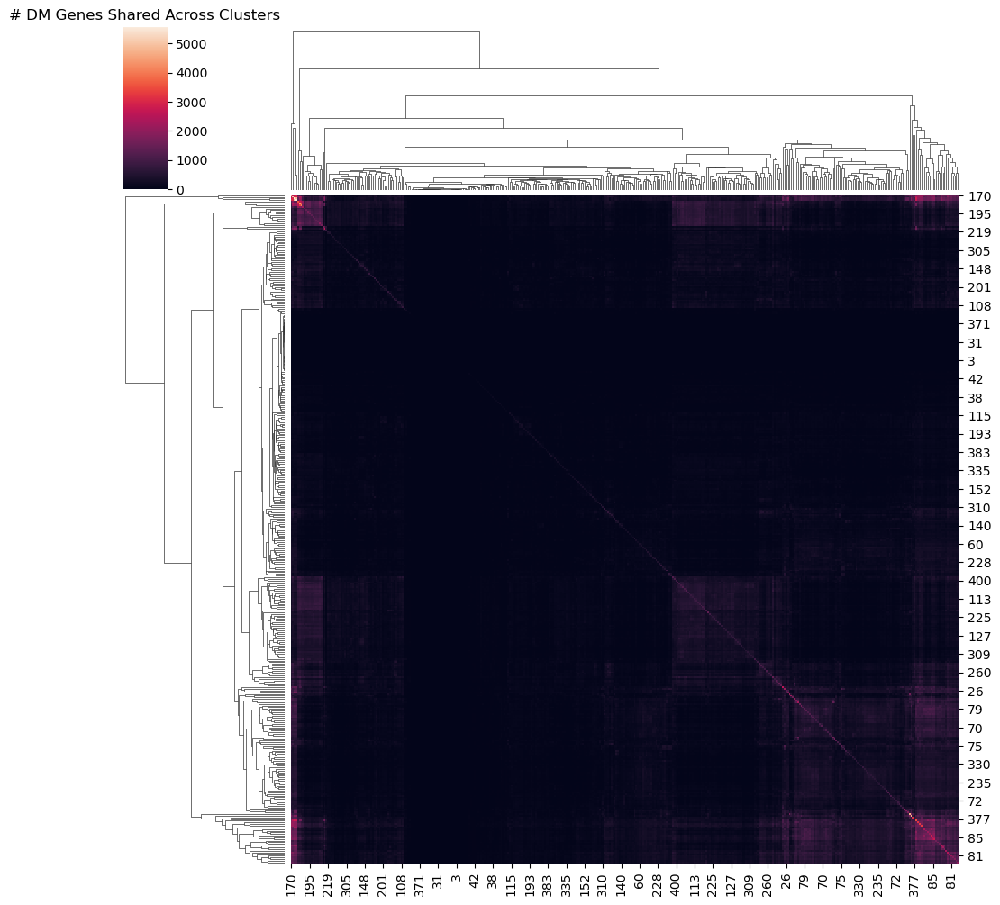

In [37]:
dm_sub=dm_diffs[0]-dm_diffs[2]
seaborn.clustermap((dm_sub>0.1).astype(np.float64)@(dm_sub.T>0.1).astype(np.float64))
plt.title('# DM Genes Shared Across Clusters')

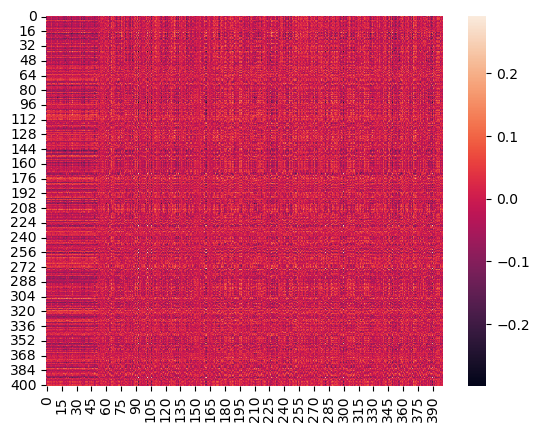

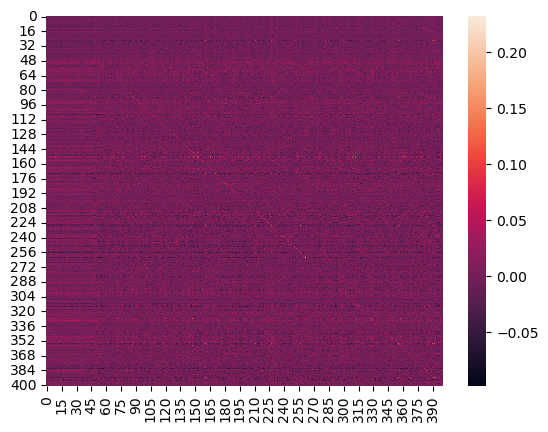

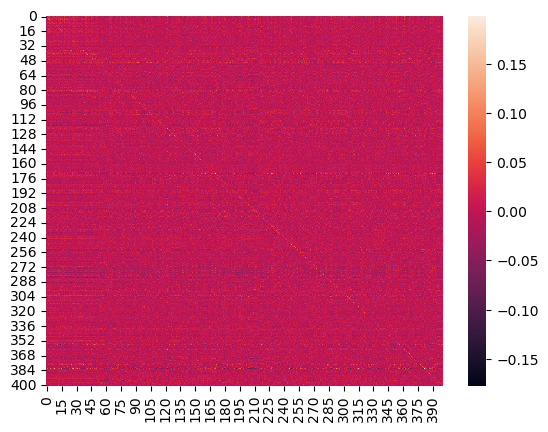

In [38]:
seaborn.heatmap(corr2_coeff((dm_diffs[0]-dm_diffs[1]),(dc_diffs[0]-dc_diffs[1])))
plt.show()
seaborn.heatmap(corr2_coeff((de_diffs[0]-de_diffs[1]),(dc_diffs[0]-dc_diffs[1])))
plt.show()
seaborn.heatmap(corr2_coeff((de_diffs[0]-de_diffs[1]),(dm_diffs[0]-dm_diffs[1])))
plt.show()

<Axes: >

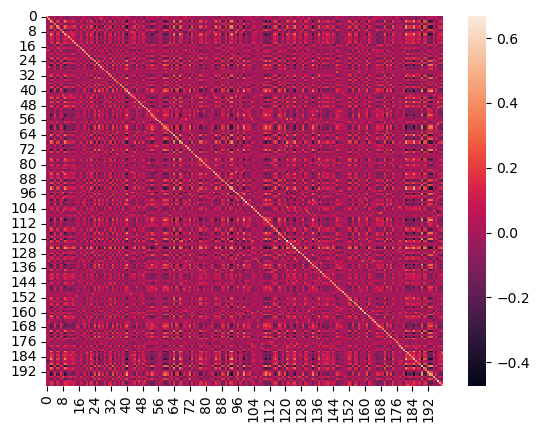

In [39]:
seaborn.heatmap(corr2_coeff(pstore['z_decoder_weight'],pstore['discov_dc'][0]))

In [41]:
seaborn.heatmap(corr2_coeff(np.exp((estimated_ge[1])),(real_ge[1])))

NameError: name 'real_ge' is not defined

In [ ]:
#seaborn.histplot((real_ge+1e-10).log().flatten())

<Axes: ylabel='Count'>

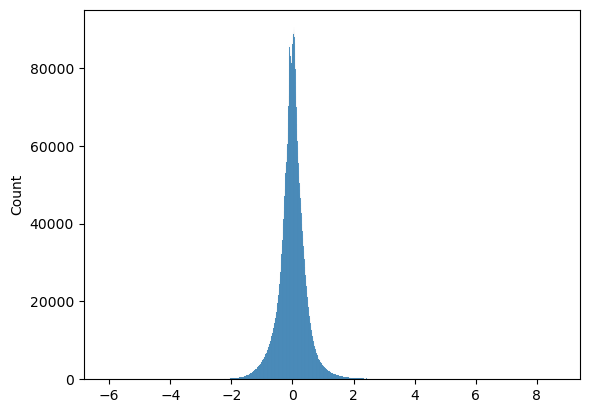

In [42]:
seaborn.histplot(estimated_ge.flatten())

###### gex_output((pstore['locs']+loc_dynams),(pstore['z_decoder_weight']+pstore['discov_dc'][0][i]),0)

In [43]:
gex_output((pstore['locs']+loc_dynams),
                                      (pstore['z_decoder_weight']+pstore['discov_dc'][1][i]),
                                      0)

IndexError: index 400 is out of bounds for axis 0 with size 200

In [44]:
(pstore['z_decoder_weight']+pstore['discov_dc'][0][i])


IndexError: index 400 is out of bounds for axis 0 with size 200

In [45]:
pstore['discov_dc'][0].shape

(200, 16738)

In [46]:
def make_col_mask(shape,ind):
    mask=torch.zeros(shape)
    mask[:,ind]=1.
    return(mask)

def make_row_mask(shape,ind):
    mask=torch.zeros(shape)
    mask[ind,...]=1.
    return(mask)

In [47]:
cluster_species=[]
for i in range(pstore['discov_dc'].shape[1]):
    mask=make_row_mask(pstore['discov_dc'][0].shape,i)
    cluster_species.append(gex_output((pstore['locs']+loc_dynams),
                                      (torch.zeros(pstore['z_decoder_weight'].shape)+pstore['discov_dc'][0]*mask),
                                      0)-gex_output((pstore['locs']+loc_dynams),
                                      (torch.zeros(pstore['z_decoder_weight'].shape)+pstore['discov_dc'][1]*mask),
                                      0))

    """
cluster_species=[]   
for i in range(pstore['discov_dc'].shape[1]):
    cluster_species.append(gex_output((pstore['locs']+loc_dynams),
                                      (torch.ones(pstore['z_decoder_weight'].shape)+pstore['discov_dc'][0][i]),
                                      0)-gex_output((pstore['locs']+loc_dynams),
                                      (torch.ones(pstore['z_decoder_weight'].shape)+torch.randn(pstore['discov_dc'][1][i].shape)),
                                      0))
"""      

cluster_species=np.stack(cluster_species)
component_diffs=cluster_species

TypeError: unsupported operand type(s) for *: 'numpy.ndarray' and 'Tensor'

In [48]:
seaborn.heatmap(torch.einsum('...bi,...ij->...bj',(pstore['locs']+loc_dynams),pstore['discov_dc'][0]))

TypeError: expected Tensor as element 0 in argument 1, but got numpy.ndarray

<Axes: >

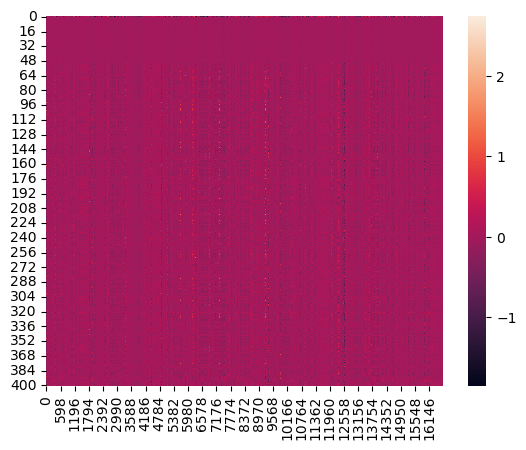

In [49]:
seaborn.heatmap((pstore['locs']+loc_dynams)@pstore['z_decoder_weight'])

<Axes: >

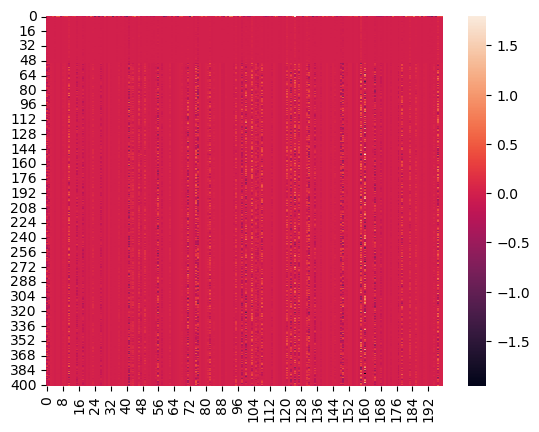

In [50]:
seaborn.heatmap(pstore['locs']+loc_dynams)

<Axes: >

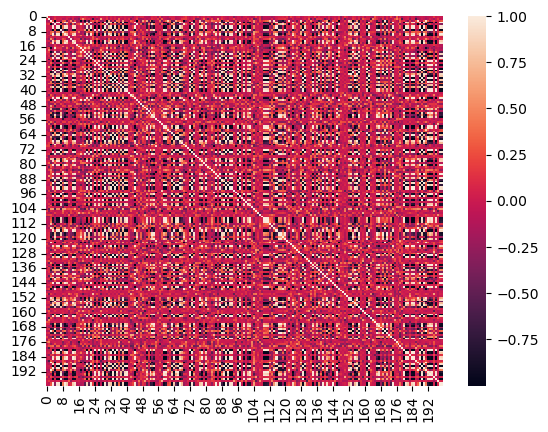

In [51]:
seaborn.heatmap(corr2_coeff((pstore['locs']+loc_dynams).T,(pstore['locs']+loc_dynams).T))


In [ ]:
seaborn.heatmap(corr2_coeff(dc_diffs[0].T,dc_diffs[1].T))

In [ ]:
component_diffs[i,:,:].T

In [ ]:
seaborn.heatmap(component_diffs[0,:,:]@component_diffs[0,:,:].T)

In [ ]:
corr2_coeff(component_diffs[i,:,:].T,component_diffs[i,:,:].T)

In [ ]:
for i in range(10):
    seaborn.heatmap(pstore['locs'][:,i:i+1])
    plt.show()
    seaborn.heatmap(component_diffs[i,:,:])
    plt.show()
    seaborn.heatmap(corr2_coeff(component_diffs[i,:,:].T,component_diffs[i,:,:].T))
    plt.show()

In [ ]:
seaborn.heatmap(corr2_coeff(pstore['discov_dc'][0],pstore['discov_dc'][1]))

In [ ]:
seaborn.heatmap(pstore['locs']+loc_dynams+pstore['discov_dm'][0])

In [ ]:
gex_output((pstore['locs']+loc_dynams+pstore['discov_dm'][species_ind]),
                                      (pstore['z_decoder_weight']+pstore['discov_dc'][species_ind]),
                                      pstore['discov_di'][species_ind])

In [ ]:
seaborn.heatmap((pstore['locs']+loc_dynams+pstore['discov_dm'][0])@(pstore['z_decoder_weight']+pstore['discov_dc'][0])+pstore['discov_di'][0])

In [ ]:
seaborn.heatmap(component_diffs[1,:,:])
plt.show()

In [ ]:
seaborn.heatmap(np.log(component_diffs.abs().sum(2)+1))
plt.show()
seaborn.heatmap(pstore['locs'].T,cmap='coolwarm')


In [ ]:
seaborn.heatmap(dc_diffs[1])

In [ ]:
seaborn.heatmap(dc_diffs[2])

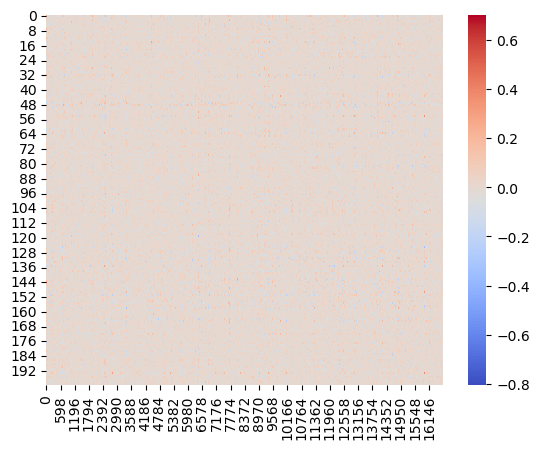

<Axes: >

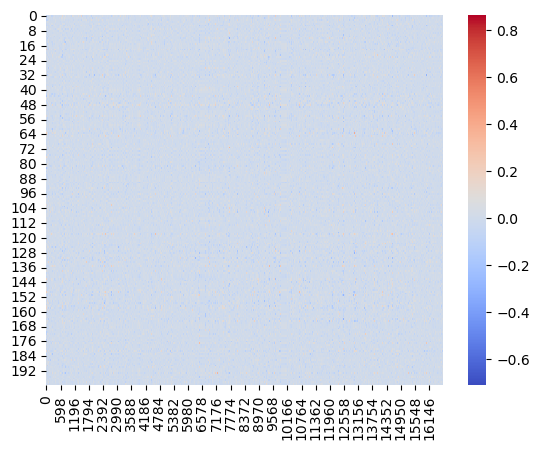

In [84]:
seaborn.heatmap(pstore['discov_dc'][0],cmap='coolwarm')
plt.show()
seaborn.heatmap(pstore['discov_dc'][1],cmap='coolwarm')

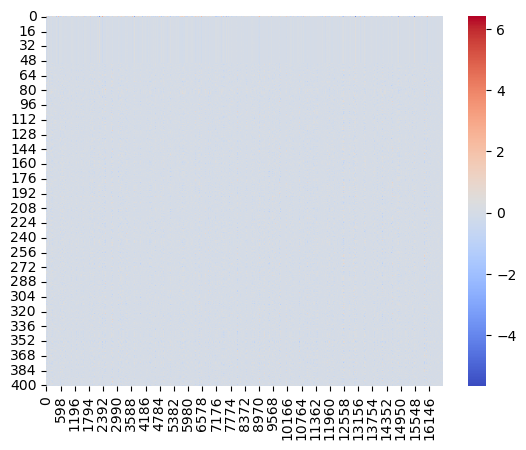


KeyboardInterrupt



Error in callback <function flush_figures at 0x7fe075ac2de0> (for post_execute), with arguments args (),kwargs {}:



KeyboardInterrupt



In [85]:
params=dc_diffs
comparison=(params[0]-params[1])
seaborn.heatmap(comparison,cmap='coolwarm')
plt.show()
seaborn.heatmap(corr2_coeff(comparison,comparison),cmap='coolwarm')



<Axes: ylabel='Count'>

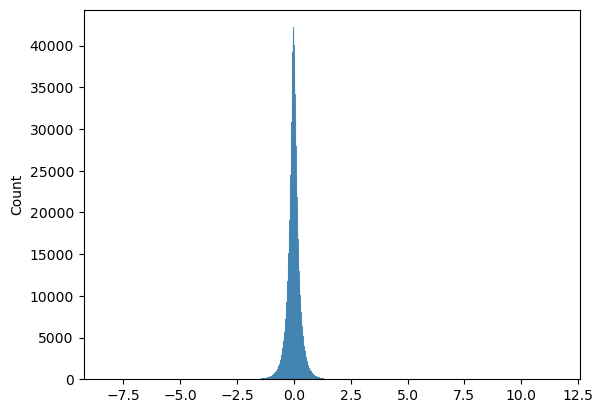

In [93]:
seaborn.histplot(comparison.flatten())

In [94]:
species_contrasts=dict(zip(['H/Q','H/M','Q/M'],[[0,1],[0,2],[1,2]]))

In [ ]:
params_dict=dict(zip(['DM','DC','DI','estimated GE'],[dm_diffs,dc_diffs,de_diffs,estimated_ge]))#,real_ge
fig, ax = plt.subplots(nrows=len(species_contrasts), ncols=len(params_dict),figsize=(30,30))
for i,listname in enumerate(species_contrasts.keys()):
    species=species_contrasts[listname]
    for j,paramname in enumerate(params_dict.keys()):
        params=params_dict[paramname]
        comparison=(params[species[0]]-params[species[1]])
        seaborn.heatmap(comparison,ax=ax[i][j],cmap='coolwarm',vmin=-1, vmax=1)
        ax[i][j].set_title(listname+' '+paramname+' Gex',y=1.)

plt.savefig(os.path.join(sc.settings.figdir,'CrossParameterMultipliedOutGexHeatmaps.pdf'),format = "pdf")

In [ ]:
params_dict=dict(zip(['DM','DC','DI','estimated GE'],[dm_diffs,dc_diffs,de_diffs,estimated_ge]))#,'real GE',real_ge
fig, ax = plt.subplots(nrows=len(species_contrasts), ncols=len(params_dict),figsize=(30,30))
for i,listname in enumerate(species_contrasts.keys()):
    species=species_contrasts[listname]
    for j,paramname in enumerate(params_dict.keys()):
        params=params_dict[paramname]
        comparison=(params[species[0]]-params[species[1]])
        seaborn.heatmap(corr2_coeff(comparison,comparison),ax=ax[i][j],cmap='coolwarm',vmin=-1, vmax=1)
        ax[i][j].set_title(listname+' '+paramname+' Corr',y=1.)

plt.savefig(os.path.join(sc.settings.figdir,'CrossParameterMultipliedOutCorrHeatmaps.pdf'),format = "pdf")

In [ ]:
params_dict=dict(zip(['DM','DC','DI','estimated GE'],[pstore['discov_dm'],pstore['discov_dc'],pstore['discov_di'],estimated_ge]))#,'real GE',,real_ge
fig, ax = plt.subplots(nrows=len(species_contrasts), ncols=len(params_dict),figsize=(30,30))
for i,(species_ind,species) in enumerate(zip(adata.obs.species.cat.codes,adata.obs.species.cat.categories)):
    for j,paramname in enumerate(params_dict.keys()):
        params=params_dict[paramname]
        comparison=params[species_ind]
        seaborn.heatmap(corr2_coeff(comparison.T,comparison),ax=ax[i][j],cmap='coolwarm',vmin=-1, vmax=1)
        ax[i][j].set_title(species+' '+paramname+' Corr',y=1.)
plt.savefig(os.path.join(sc.settings.figdir,'CrossParameterCorrHeatmaps.pdf'),format = "pdf")

In [ ]:
seaborn.clustermap(np.corrcoef(pstore['discov_dc'][0]))

# Gene Enrichments

In [74]:
tf_list=pd.read_csv('/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/gene_lists/TFs_lambert_pmid29425488_1.01.txt',sep='\t')
tf_list['hgnc_symbol']
TFs=np.where(adata.var.index.isin(tf_list['hgnc_symbol']))[0]
notTFs=np.where(~adata.var.index.isin(tf_list['hgnc_symbol']))[0]

In [75]:
custom_params = {"axes.spines.right": False, "axes.spines.top": False}
seaborn.set_theme(style="ticks", rc=custom_params)

In [76]:
top_path='/allen/programs/celltypes/workgroups/rnaseqanalysis/EvoGen/Team/Matthew/data/taxtest/gene_lists/synteny'
qHtQ_syntenic=pd.read_csv(os.join(top_path,'qHtQ_syntenic.tsv'),sep='\t')
qQtH_syntenic=pd.read_csv(os.join(top_path,'qQtH_syntenic.tsv'),sep='\t')
qHtM_syntenic=pd.read_csv(os.join(top_path,'qHtM_syntenic.tsv'),sep='\t')
qMtH_syntenic=pd.read_csv(os.join(top_path,'qMtH_syntenic.tsv'),sep='\t')
qQtM_syntenic=pd.read_csv(os.join(top_path,'qQtM_syntenic.tsv'),sep='\t')
qMtQ_syntenic=pd.read_csv(os.join(top_path,'qMtQ_syntenic.tsv'),sep='\t')

In [77]:
HQgenes=qHtQ_syntenic['17'].unique()
QHgenes=qQtH_syntenic['3'].str.replace('^ENST[0-9]+\.','').str.replace('\.[0-9]*$','').unique()

/tmp/ipykernel_297111/580338828.py:2: FutureWarning: The default value of regex will change from True to False in a future version.
  QHgenes=qQtH_syntenic['3'].str.replace('^ENST[0-9]+\.','').str.replace('\.[0-9]*$','').unique()


In [78]:
def resampling_p_value(data, group_labels,fun, num_iterations=1000):
    """
    Calculate the resampling p-value for the magnitude of input values, partitioned by two groups.
    
    Arguments:
    data -- A list or NumPy array of input values.
    group_labels -- A list or NumPy array of group labels corresponding to each value in the data.
    num_iterations -- The number of iterations to perform for the resampling (default: 1000).
    
    Returns:
    p_value -- The resampling p-value.
    """
    group_labels = np.array(group_labels)
    data = np.array(data)
    group1_data = data[group_labels]
    group2_data = data[~group_labels]
    observed_difference = np.abs(np.mean(fun(group1_data)) - np.mean(fun(group2_data)))

    combined_data = np.concatenate((group1_data, group2_data))
    num_group1 = len(group1_data)
    num_group2 = len(group2_data)
    num_total = num_group1 + num_group2
    larger_difference_count = 0

    for _ in tqdm.tqdm(range(num_iterations)):
        np.random.shuffle(combined_data)
        perm_group1 = combined_data[:num_group1]
        perm_group2 = combined_data[num_group1:]
        perm_difference = np.abs(np.mean(fun(perm_group1)) - np.mean(fun(perm_group2)))
        if perm_difference >= observed_difference:
            larger_difference_count += 1

    p_value = (larger_difference_count + 1) / (num_iterations + 1)
    return p_value

def resampling_slope_p_value(x, y, num_iterations=1000):
    """
    Calculate the resampling p-value for the slope of the linear fit of two variables.
    
    Arguments:
    x -- A 1D NumPy array or list representing the independent variable.
    y -- A 1D NumPy array or list representing the dependent variable.
    num_iterations -- The number of iterations to perform for the resampling (default: 1000).
    
    Returns:
    p_value -- The resampling p-value.
    """
    x = np.array(x)
    y = np.array(y)
    observed_slope = np.polyfit(x, y, 1)[0]
    num_data = len(x)
    larger_slope_count = 0

    for _ in tqdm.tqdm(range(num_iterations)):
        indices = np.random.choice(num_data, num_data, replace=True)
        resampled_x = x
        resampled_y = y[indices]
        resampled_slope = np.polyfit(resampled_x, resampled_y, 1)[0]
        if np.abs(resampled_slope) >= np.abs(observed_slope):
            larger_slope_count += 1

    p_value = (larger_slope_count + 1) / (num_iterations + 1)
    return p_value

num_iterations=5000

100%|██████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:45<00:00, 109.78it/s]


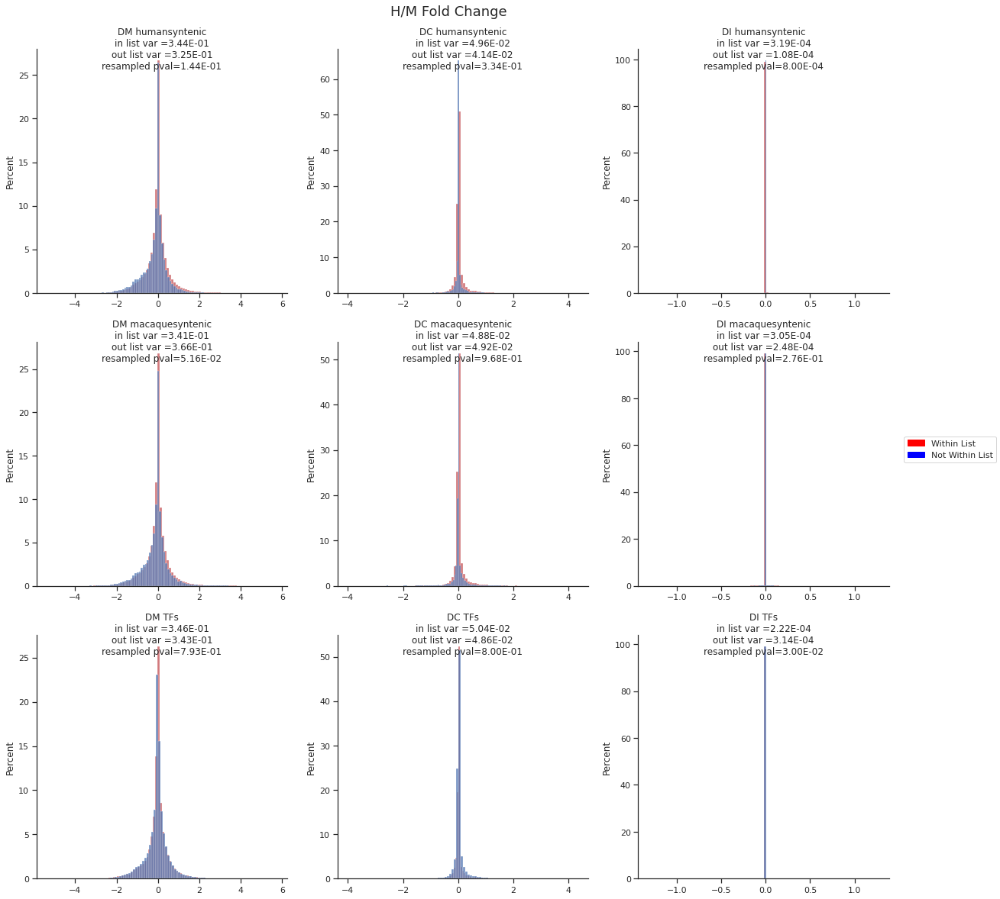

In [79]:
def flatten_var(x):
    return(np.var(x.flatten()))
    
genelists=dict(zip(['humansyntenic','macaquesyntenic','TFs'],[HQgenes,QHgenes,tf_list['HGNC symbol']]))
params_dict=dict(zip(['DM','DC','DI'],[dm_diffs,dc_diffs,de_diffs]))
fig, ax = plt.subplots(nrows=len(genelists), ncols=len(params_dict),figsize=(20,20))
abs_magnitudes=np.abs(dm_diffs[0]-dm_diffs[1])+np.abs(de_diffs[0]-de_diffs[1])+np.abs(dc_diffs[0]-dc_diffs[1])
for i,listname in enumerate(genelists.keys()):
    genes=genelists[listname]
    for j,paramname in enumerate(params_dict.keys()):
        params=params_dict[paramname]
        gidx=np.where(adata.var.index.isin(genes))[0]
        ngidx=np.where(~adata.var.index.isin(genes))[0]
        comparison=(params[0]-params[1])
        
        seaborn.histplot(np.clip((comparison)[:,gidx].flatten(),-10,10),bins=100,stat='percent',color='r',ax=ax[i][j])
        seaborn.histplot(np.clip((comparison)[:,ngidx].flatten(),-10,10),bins=100,stat='percent',ax=ax[i][j])
        pval=resampling_p_value((comparison).T, adata.var.index.isin(genes),flatten_var, num_iterations=num_iterations)
        ax[i][j].set_title(paramname+" "+listname+'\n'+
                          'in list var ='+'%.2E'%Decimal(str(np.var(comparison[:,gidx].flatten())))+'\n'+
                           'out list var ='+'%.2E'%Decimal(str(np.var(comparison[:,ngidx].flatten())))+'\n'+
                           'resampled pval='+'%.2E'%Decimal(str(pval)),
                           y=0.9
                          )
        #ax[i][j].set_title('in median ='+str(np.median(comparison[:,gidx]))+'\nout median ='+str(np.median(comparison[:,ngidx])),y=0.8, fontsize=10)
red_patch = matplotlib.patches.Patch(color='red', label='Within List')
blue_patch = matplotlib.patches.Patch(color='blue', label='Not Within List')
fig.legend(handles=[red_patch,blue_patch],loc='center right')
fig.suptitle('H/M Fold Change',y=0.92,fontsize=18)
plt.show(fig)

100%|███████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [01:13<00:00, 68.43it/s]


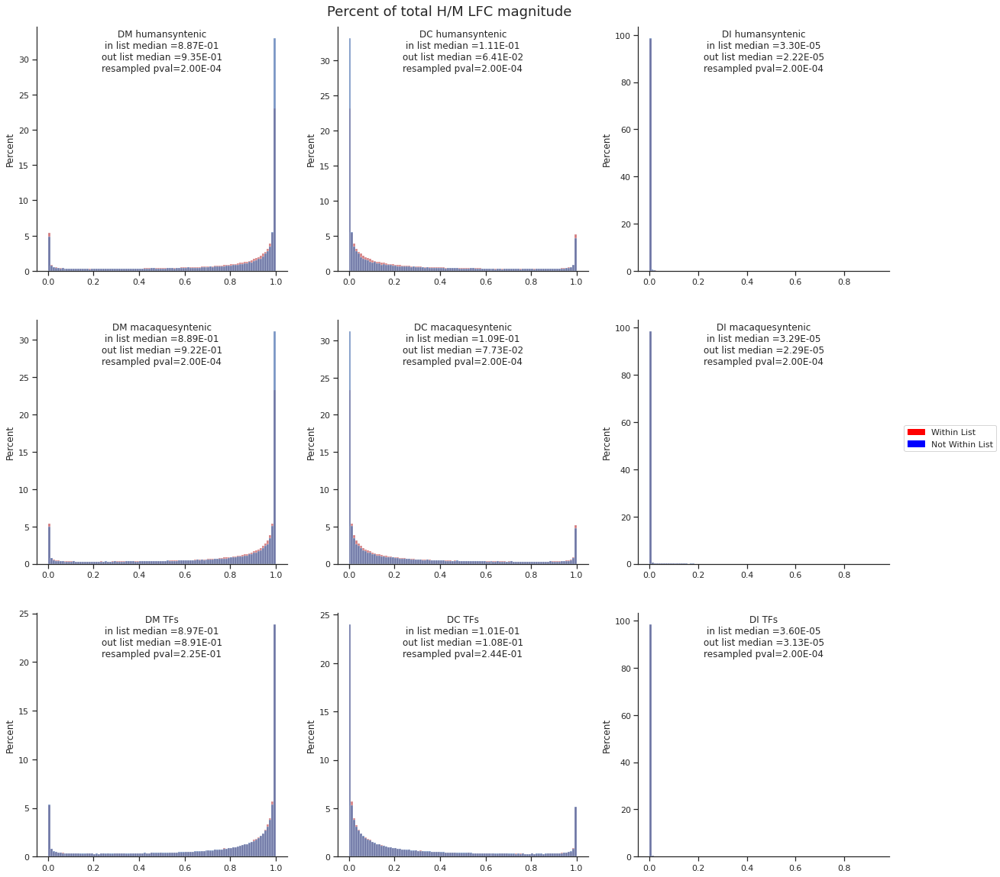

In [80]:
def flatten_median(x):
    return(np.median(x.flatten()))

genelists=dict(zip(['humansyntenic','macaquesyntenic','TFs'],[HQgenes,QHgenes,tf_list['hgnc_symbol']]))
params_dict=dict(zip(['DM','DC','DI'],[dm_diffs,dc_diffs,de_diffs]))
fig, ax = plt.subplots(nrows=len(genelists), ncols=len(params_dict),figsize=(20,20))
abs_magnitudes=np.abs(dm_diffs[0]-dm_diffs[1])+np.abs(de_diffs[0]-de_diffs[1])+np.abs(dc_diffs[0]-dc_diffs[1])
for i,listname in enumerate(genelists.keys()):
    genes=genelists[listname]
    for j,paramname in enumerate(params_dict.keys()):
        params=params_dict[paramname]
        gidx=np.where(adata.var.index.isin(genes))[0]
        ngidx=np.where(~adata.var.index.isin(genes))[0]
        comparison=(params[0]-params[1]).abs()/(abs_magnitudes)
        seaborn.histplot(np.clip((comparison)[:,gidx].flatten(),-1,1),bins=100,stat='percent',color='r',ax=ax[i][j])
        seaborn.histplot(np.clip((comparison)[:,ngidx].flatten(),-1,1),bins=100,stat='percent',ax=ax[i][j])
        pval=resampling_p_value((comparison).T, adata.var.index.isin(genes),flatten_median, num_iterations=num_iterations)
        ax[i][j].set_title(paramname+" "+listname+'\n'+
                          'in list median ='+'%.2E'%Decimal(str(np.median(comparison[:,gidx])))+'\n'+
                          'out list median ='+'%.2E'%Decimal(str(np.median(comparison[:,ngidx])))+'\n'+
                          'resampled pval='+'%.2E'%Decimal(str(pval)),
                           y=0.80
                          )
        #ax[i][j].set_title('in median ='+str(np.median(comparison[:,gidx]))+'\nout median ='+str(np.median(comparison[:,ngidx])),y=0.8, fontsize=10)

red_patch = matplotlib.patches.Patch(color='red', label='Within List')
blue_patch = matplotlib.patches.Patch(color='blue', label='Not Within List')
fig.legend(handles=[red_patch,blue_patch],loc='center right')
fig.suptitle('Percent of total H/M LFC magnitude',y=0.9,fontsize=18)
plt.show(fig)

In [81]:
q_length_intergenic=pd.read_csv('/mnt/sda/toga_annotations/GeneSizeAndIntergenic_Q.tsv',sep='\t')
h_length_intergenic=pd.read_csv('/mnt/sda/toga_annotations/GeneSizeAndIntergenic_H.tsv',sep='\t')
m_length_intergenic=pd.read_csv('/mnt/sda/toga_annotations/GeneSizeAndIntergenic_M.tsv',sep='\t')

<AxesSubplot:ylabel='Count'>

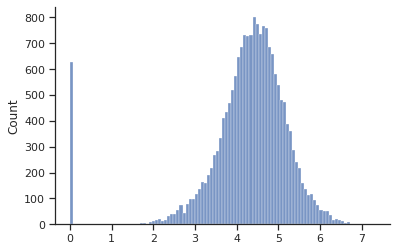

In [82]:
seaborn.histplot(np.log10(h_length_intergenic['left']+m_length_intergenic['right']+1))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1296.42it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1259.53it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|███

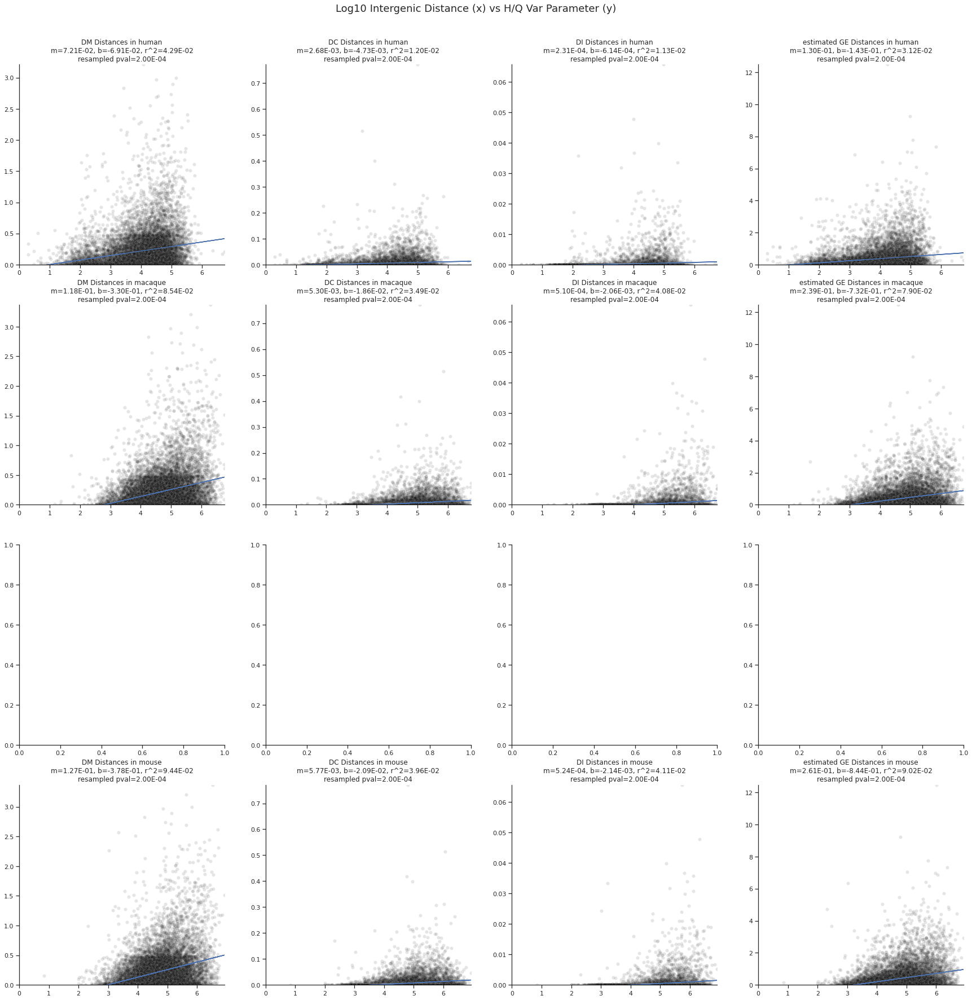

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1357.86it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1532.29it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|███

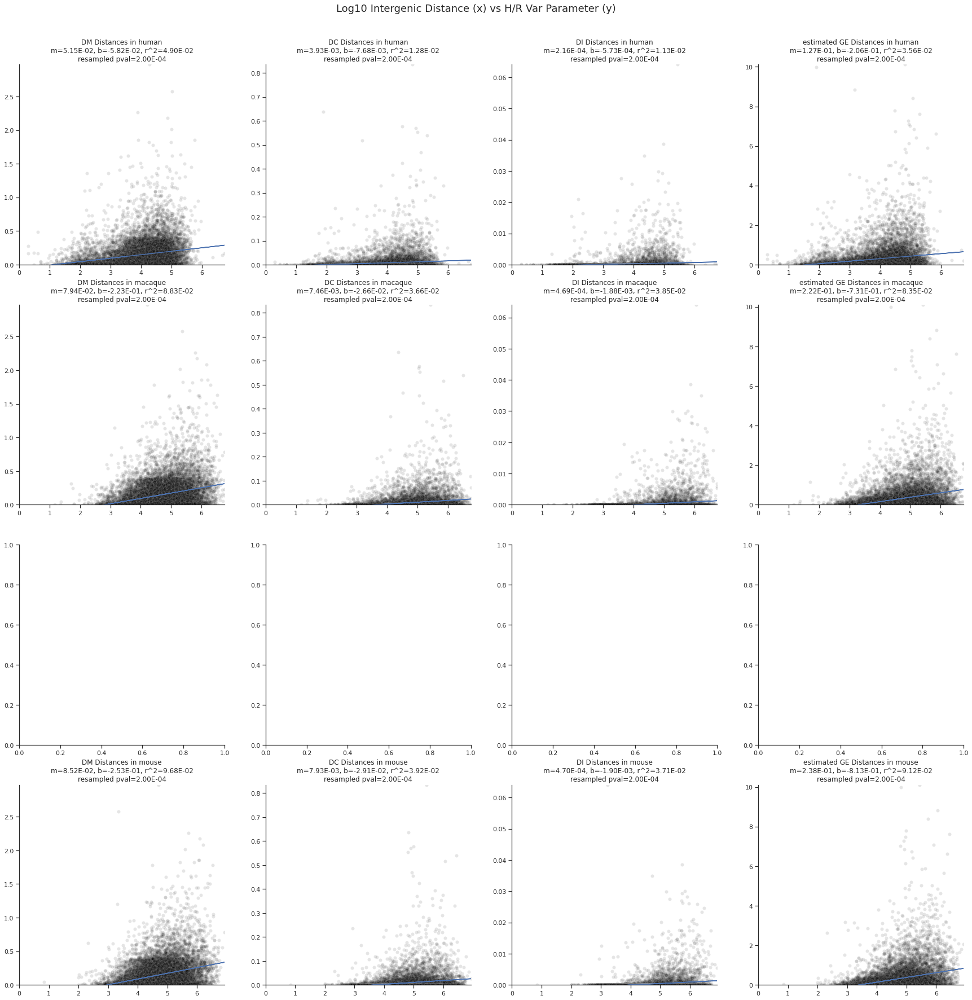

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1311.43it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1524.24it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|███

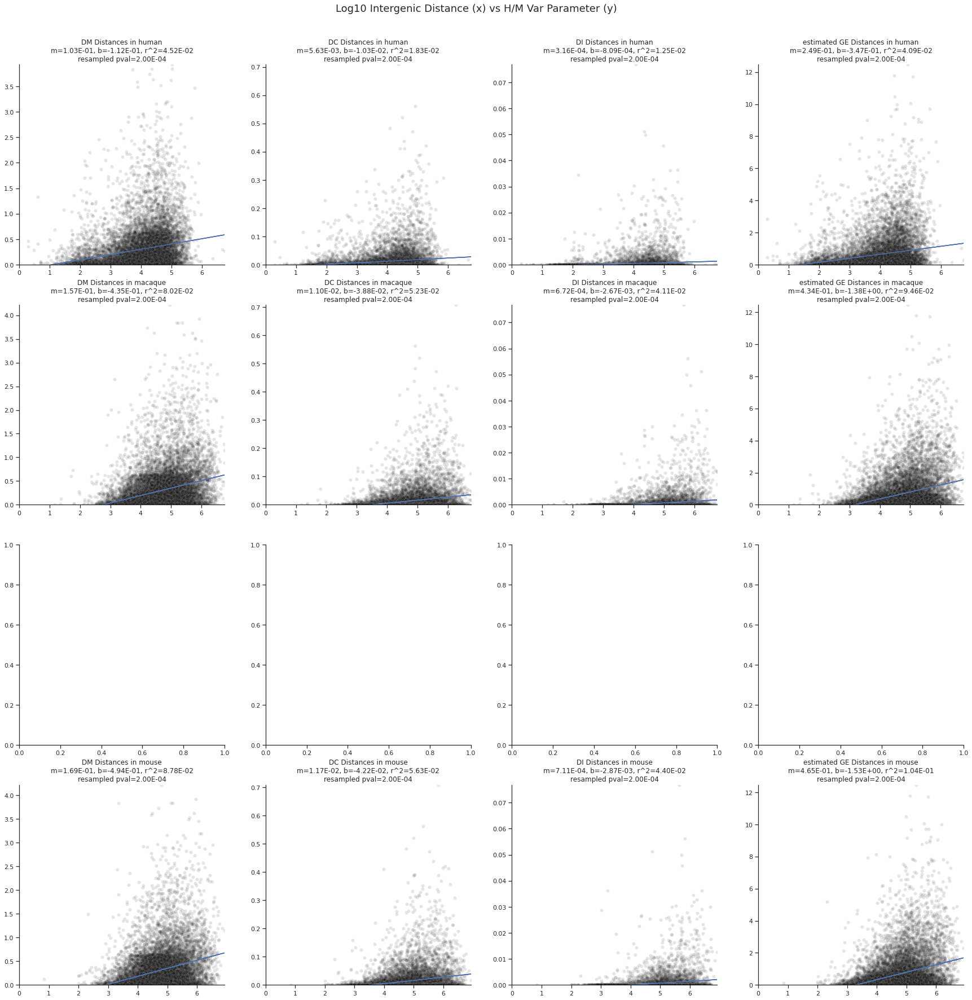

100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1290.28it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1299.91it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|███

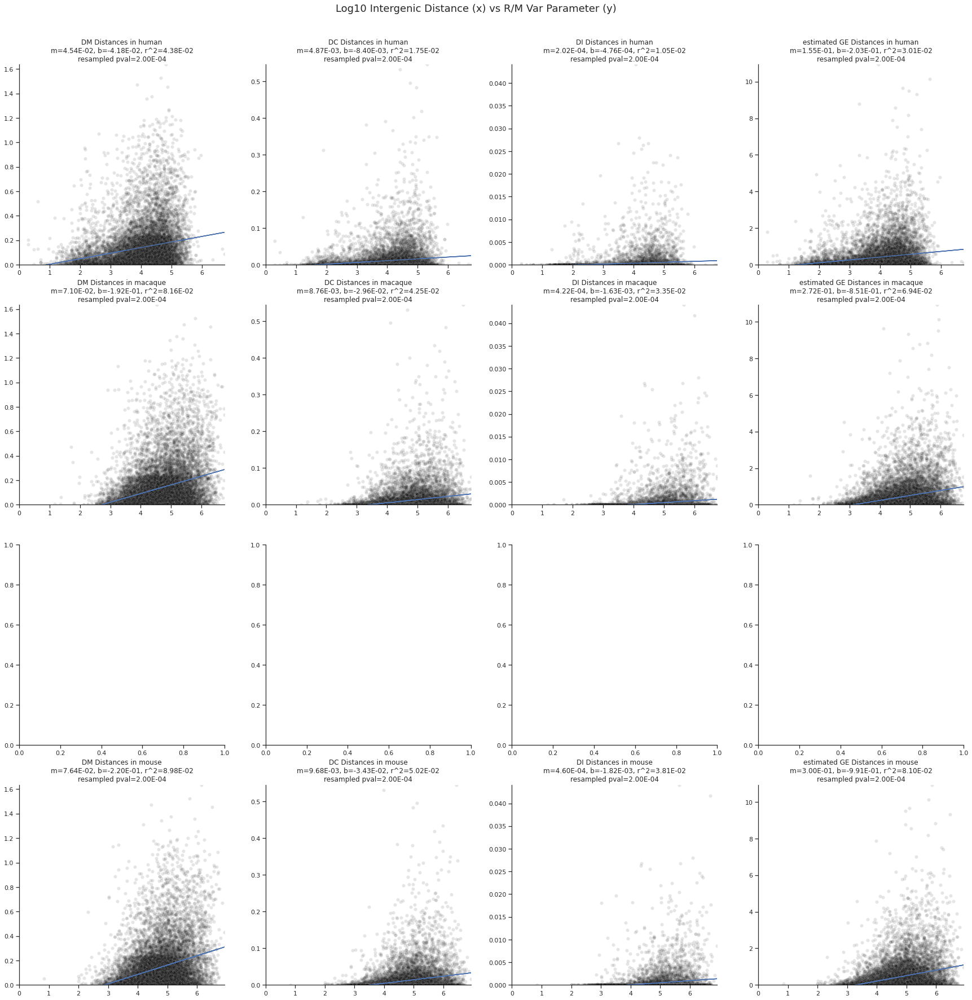

In [83]:

#Intergenic Distance
intergenic_dfs=dict(zip(['human','macaque','mouse'],[h_length_intergenic,q_length_intergenic,m_length_intergenic]))
species_dict=dict(zip(adata.obs.species.cat.categories,list(range(pstore['discov_di'].shape[0]))))
params_dict=dict(zip(['DM','DC','DI','estimated GE'],[dm_diffs,dc_diffs,de_diffs,estimated_ge]))#,'real GE',real_ge

for contrast in species_contrasts.keys():
    fig, ax = plt.subplots(nrows=len(species_dict), ncols=len(params_dict),figsize=(30,30))
    for i,species in enumerate(species_dict.keys()):
        species_ind=species_dict[species]
        for j,paramname in enumerate(params_dict.keys()):
            if species not in intergenic_dfs.keys():
                continue
            params=params_dict[paramname]
            idf=intergenic_dfs[species]
            idf=idf.loc[(idf.loc[:,'left']+idf.loc[:,'right'])>0,:]
            param_contrast=params[species_contrasts[contrast][0]]-params[species_contrasts[contrast][1]]
            adata_genes=adata.var.index.isin(idf['gene'])
            genes=adata.var.index[adata_genes]
            idf.index=idf['gene']
            idf=idf.loc[genes,:]
            x=np.log10(idf.loc[:,'left']+idf.loc[:,'right']+1)
            #x=np.log10(idf.loc[:,['left','right']].min(1)+1)
            y=param_contrast[:,adata_genes].var(0)
            pval=resampling_slope_p_value(x.to_numpy(),y, num_iterations=num_iterations)

            #y=np.abs(param_contrast[:,adata_genes]).max(0)[0]
            seaborn.scatterplot(x,y,color='black',ax=ax[i][j],alpha=0.1,legend=None)        
            a, b = np.polyfit(x, y, 1)
            model=np.poly1d([a,b])
            ax[i][j].plot(x, a*x+b)
            ax[i][j].set_xlim((0,x.max()))
            ax[i][j].set_ylim((0,y.max()))
            r2=sklearn.metrics.r2_score(y,model(x))
            #seaborn.regplot((idf.loc[:,'left']+idf.loc[:,'right']+1),param_contrast[:,adata_genes].var(0).flatten(),color='black',ax=ax[i][j])        
            ax[i][j].set_title(paramname+" Distances in "+species+'\n'+
                               'm='+'%.2E'%Decimal(a)+', b='+'%.2E'%Decimal(b)+', r^2='+'%.2E'%Decimal(r2)+'\n'+
                                'resampled pval='+'%.2E'%Decimal(str(pval)),
                               y=1
                              )
            #ax[i][j].set_title('in median ='+str(np.median(comparison[:,gidx]))+'\nout median ='+str(np.median(comparison[:,ngidx])),y=0.8, fontsize=10)
    fig.suptitle('Log10 Intergenic Distance (x) vs '+contrast+' Var Parameter (y)',y=0.93,fontsize=18)
    plt.show(fig)

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:02<00:00, 2139.38it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:02<00:00, 2125.23it/s]
/home/mt

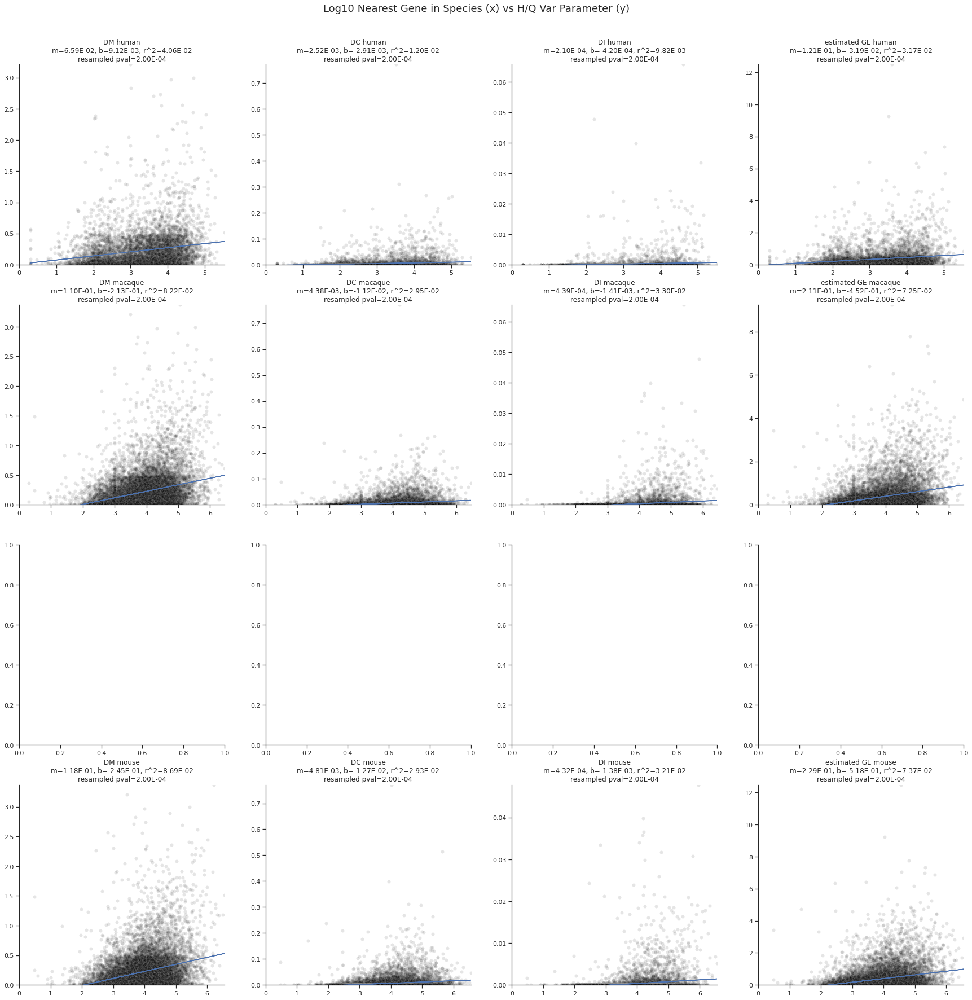

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:02<00:00, 2238.05it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:01<00:00, 2616.06it/s]
/home/mt

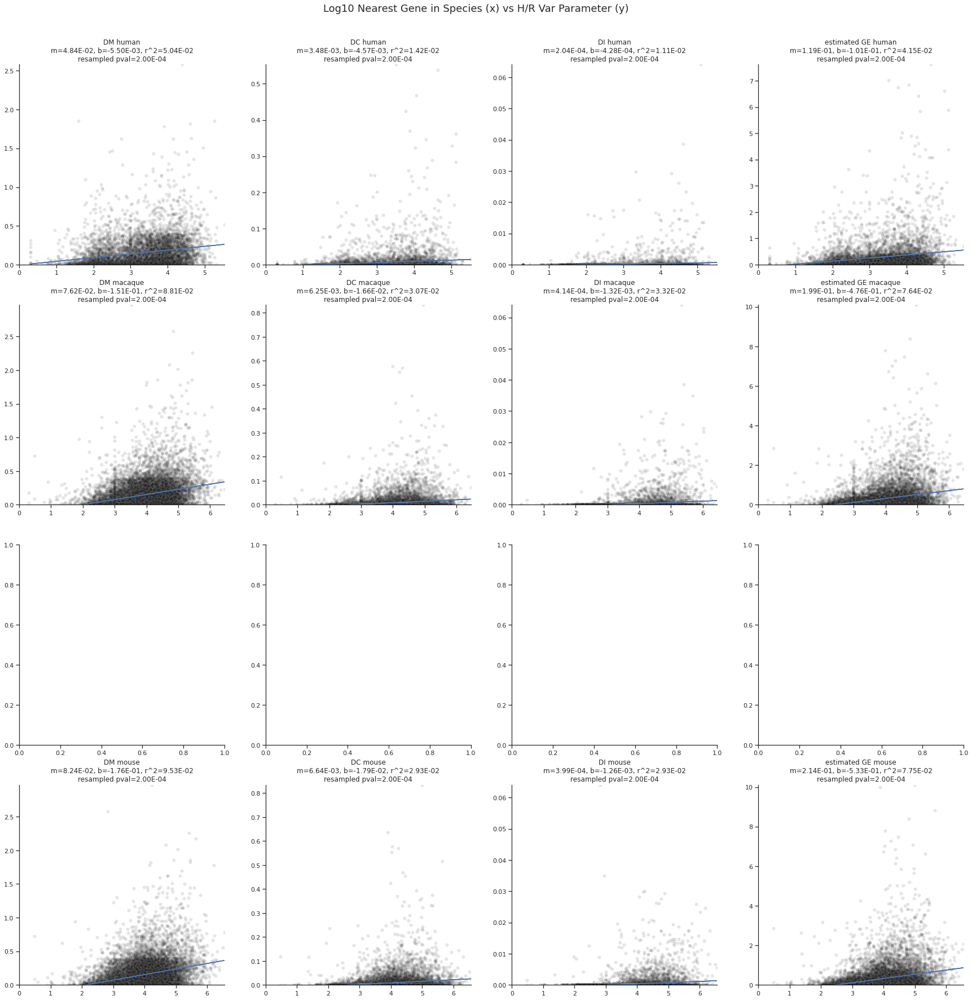

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:01<00:00, 2583.02it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:01<00:00, 2616.41it/s]
/home/mt

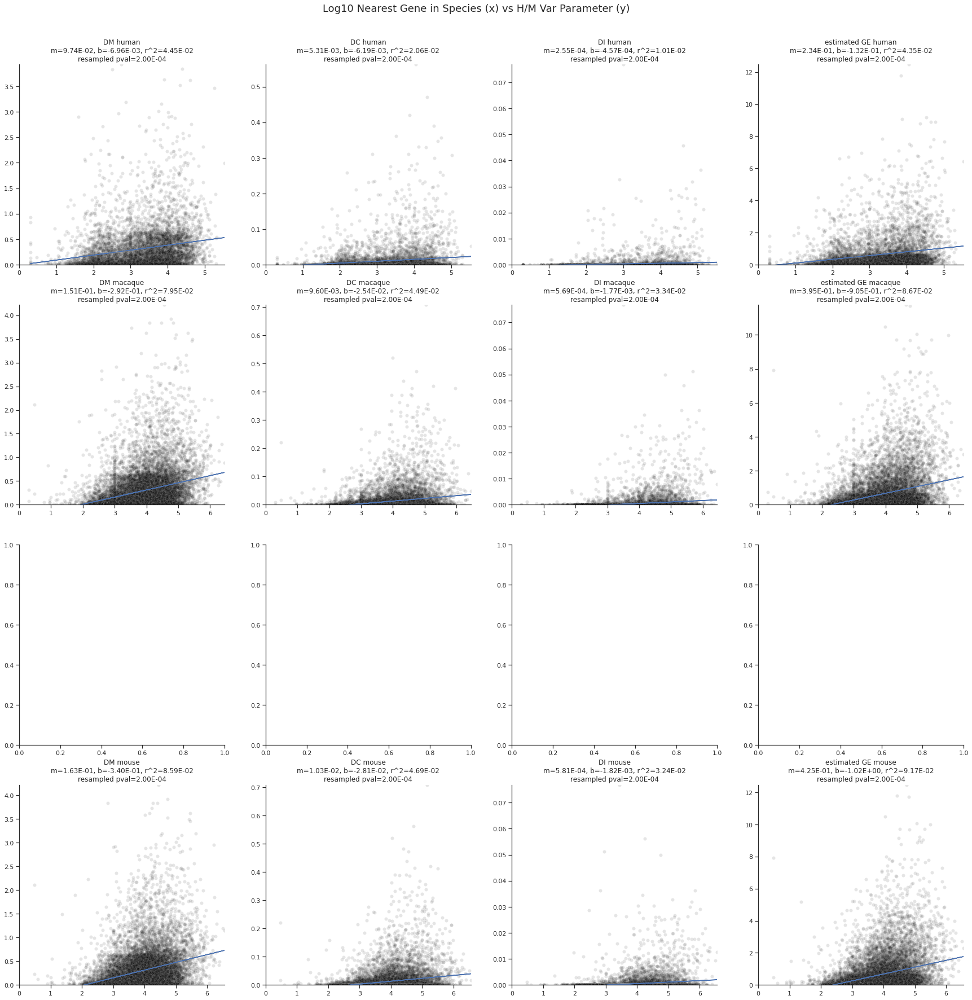

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:01<00:00, 2632.44it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:02<00:00, 2249.73it/s]
/home/mt

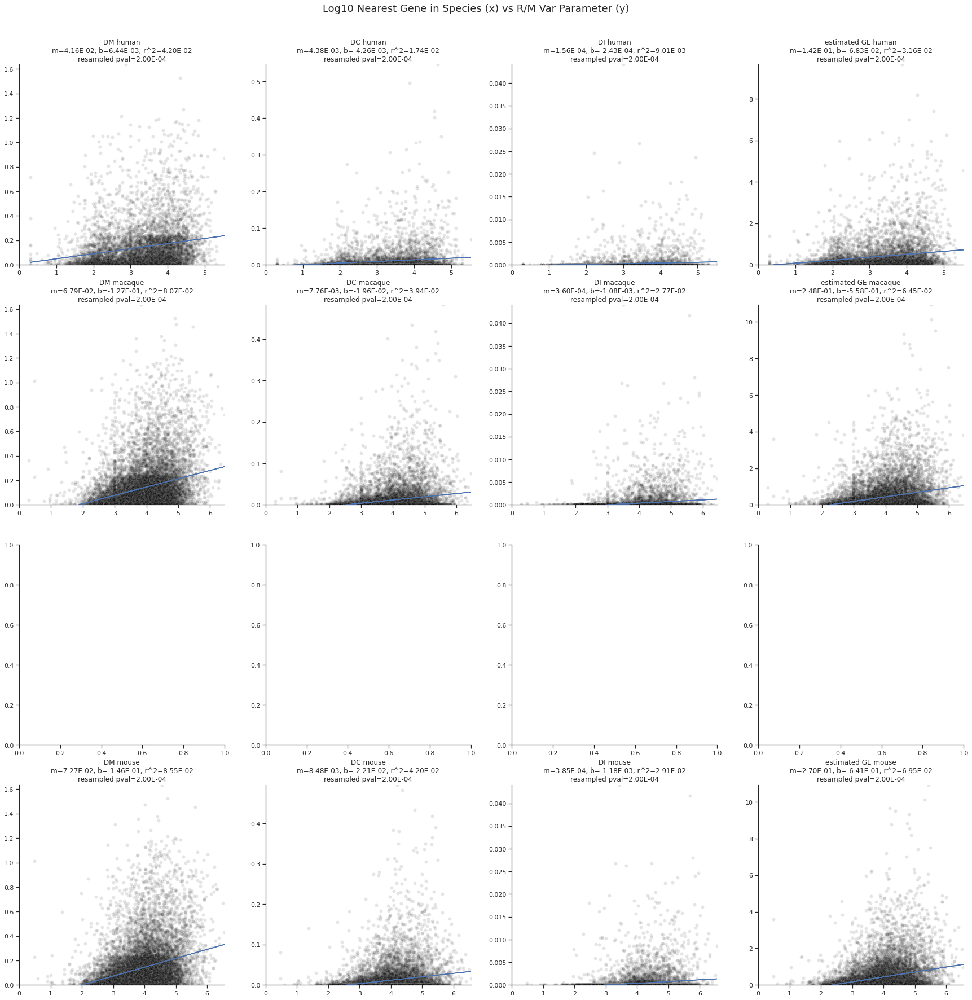

In [84]:
#Distance To Closest gene 
intergenic_dfs=dict(zip(['human','macaque','mouse'],[h_length_intergenic,q_length_intergenic,m_length_intergenic]))
species_dict=dict(zip(adata.obs.species.cat.categories,list(range(pstore['discov_di'].shape[0]))))
params_dict=dict(zip(['DM','DC','DI','estimated GE'],[dm_diffs,dc_diffs,de_diffs,estimated_ge]))#,'real GE',real_ge

for contrast in species_contrasts.keys():
    fig, ax = plt.subplots(nrows=len(species_dict), ncols=len(params_dict),figsize=(30,30))
    for i,species in enumerate(species_dict.keys()):
        species_ind=species_dict[species]
        for j,paramname in enumerate(params_dict.keys()):
            if species not in intergenic_dfs.keys():
                continue
            params=params_dict[paramname]
            idf=intergenic_dfs[species]
            idf=idf.loc[(idf.loc[:,'left']+idf.loc[:,'right'])>0,:]
            idf=idf.loc[idf.loc[:,['left','right']].min(1)>0,:]

            param_contrast=params[species_contrasts[contrast][0]]-params[species_contrasts[contrast][1]]
            adata_genes=adata.var.index.isin(idf['gene'])
            genes=adata.var.index[adata_genes]
            idf.index=idf['gene']
            idf=idf.loc[genes,:]
            #x=idf.loc[:,'left'],idf.loc[:,'right']
            x=np.log10(idf.loc[:,['left','right']].min(1)+1)
            y=param_contrast[:,adata_genes].var(0)
            #y=np.abs(param_contrast[:,adata_genes]).max(0)[0]
            seaborn.scatterplot(x,y,color='black',ax=ax[i][j],alpha=0.1)        
            a, b = np.polyfit(x, y, 1)
            model=np.poly1d([a,b])
            ax[i][j].plot(x, a*x+b)
            r2=sklearn.metrics.r2_score(y,model(x))
            ax[i][j].set_xlim((0,x.max()))
            ax[i][j].set_ylim((0,y.max()))
            pval=resampling_slope_p_value(x.to_numpy(),y, num_iterations=num_iterations)
                                            
            #seaborn.regplot((idf.loc[:,'left']+idf.loc[:,'right']+1),param_contrast[:,adata_genes].var(0).flatten(),color='black',ax=ax[i][j])        
            ax[i][j].set_title(paramname+" "+species+'\n'+
                               'm='+'%.2E'%Decimal(str(a))+', b='+'%.2E'%Decimal(str(b))+', r^2='+'%.2E'%Decimal(str(r2))+
                               '\n'+'resampled pval='+'%.2E'%Decimal(str(pval)),
                               y=1
                              )
            #ax[i][j].set_title('in median ='+str(np.median(comparison[:,gidx]))+'\nout median ='+str(np.median(comparison[:,ngidx])),y=0.8, fontsize=10)
    fig.suptitle('Log10 Nearest Gene in Species (x) vs '+contrast+' Var Parameter (y)',y=0.93,fontsize=18)
    plt.show(fig)

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1410.04it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:04<00:00, 1194.41it/s]
/home/mt

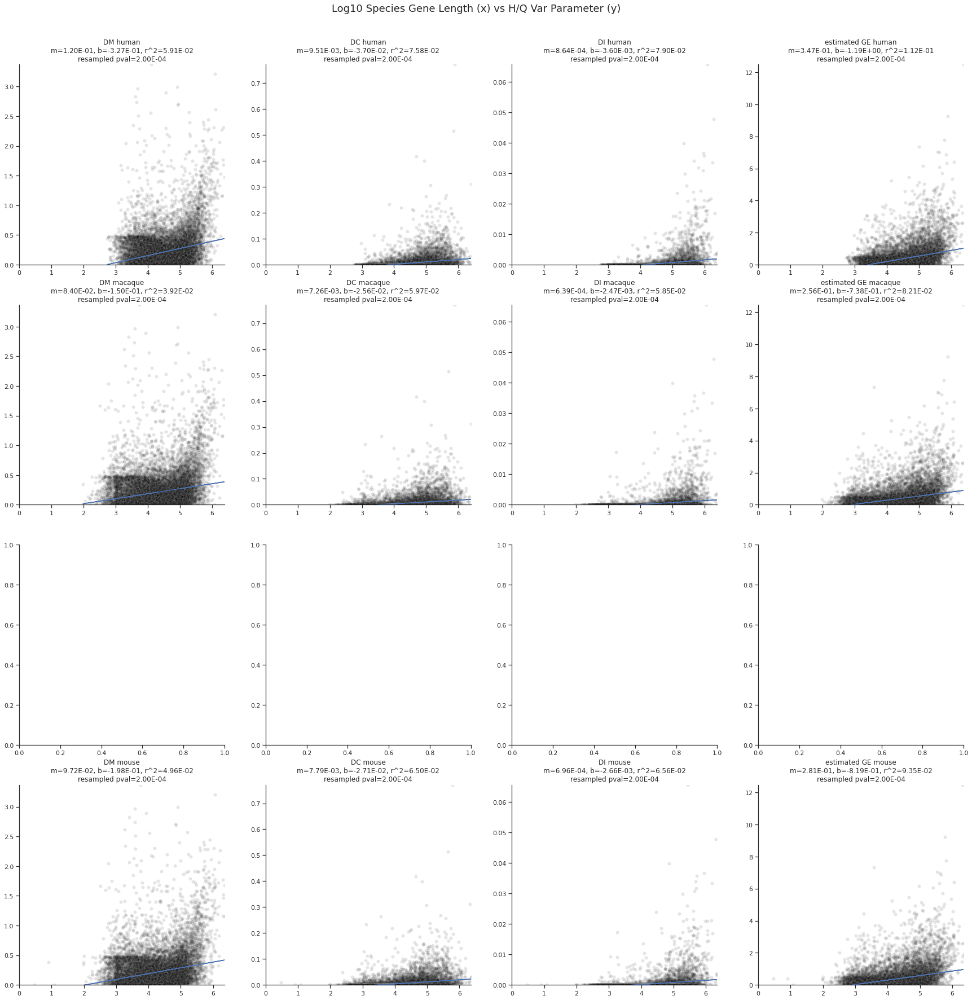

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1404.68it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1395.33it/s]
/home/mt

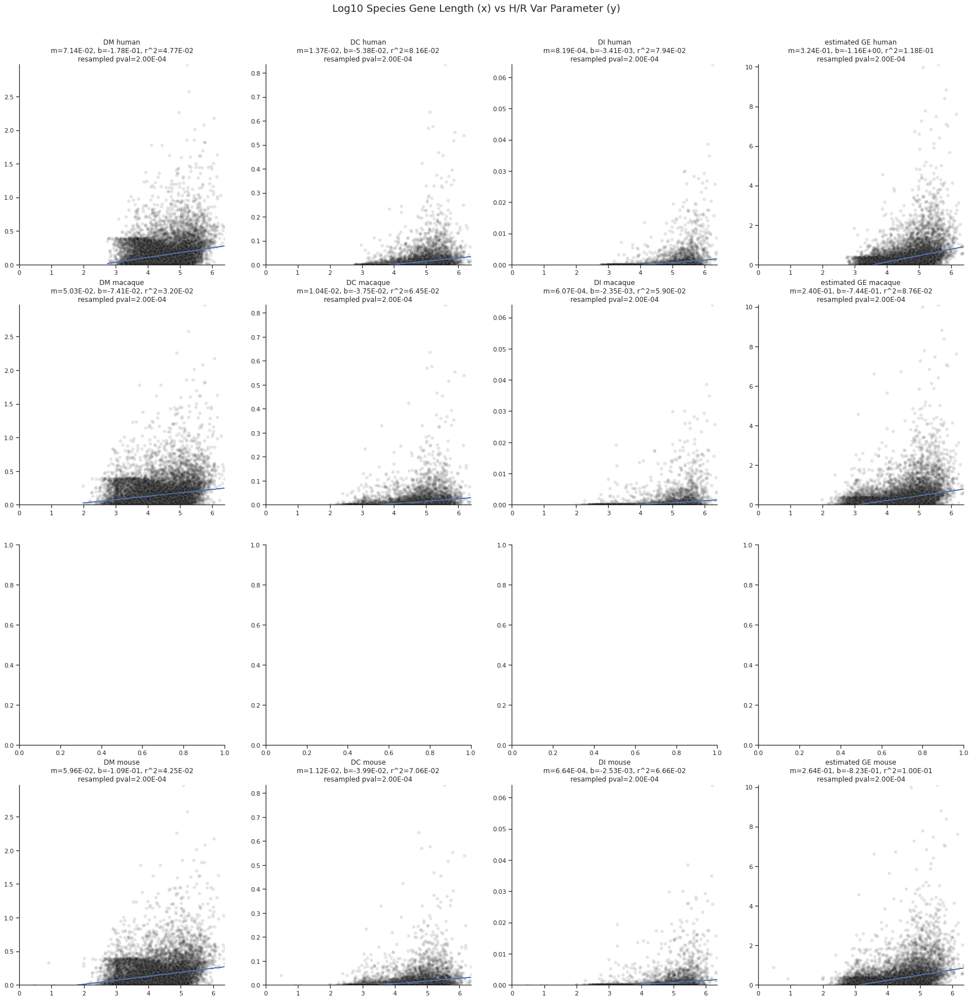

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:04<00:00, 1192.70it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1403.55it/s]
/home/mt

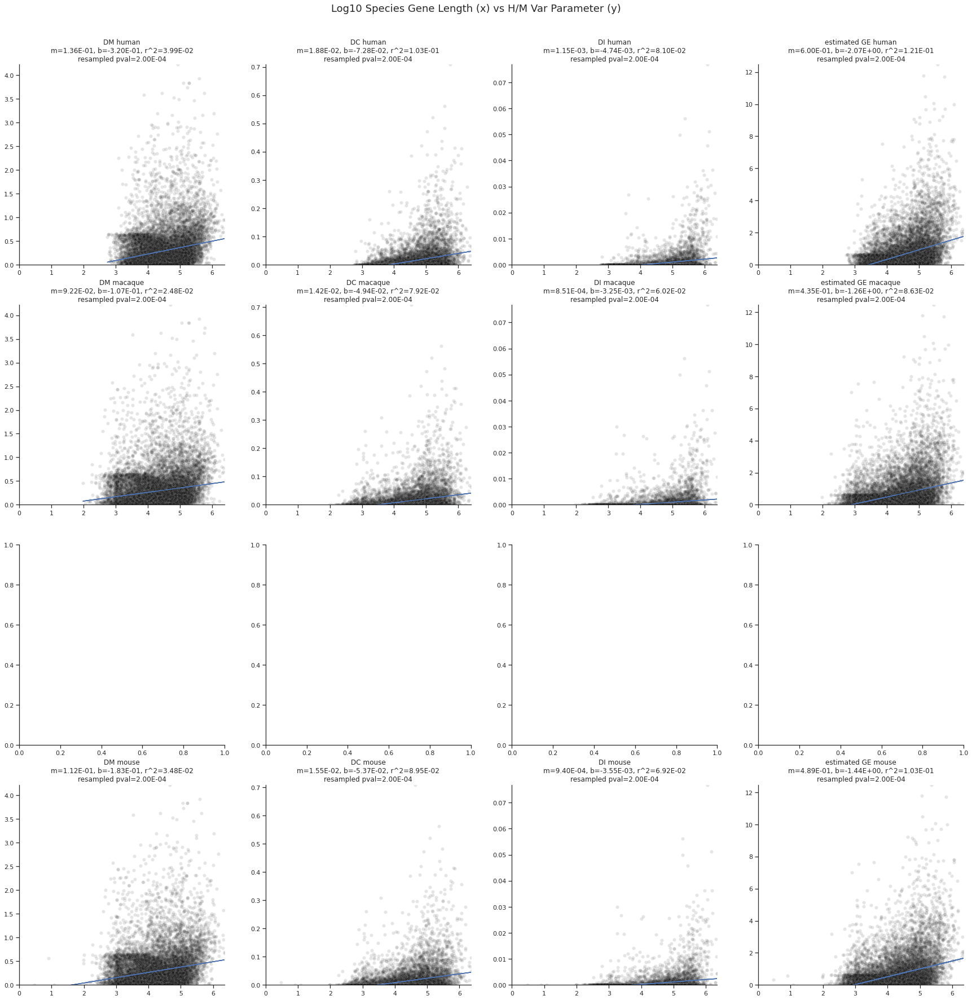

/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1416.75it/s]
/home/mtschmitz/utils/miniconda3/envs/pyro/lib/python3.10/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(
100%|█████████████████████████████████████████████████████████████████████████████████████████████████| 5000/5000 [00:03<00:00, 1401.94it/s]
/home/mt

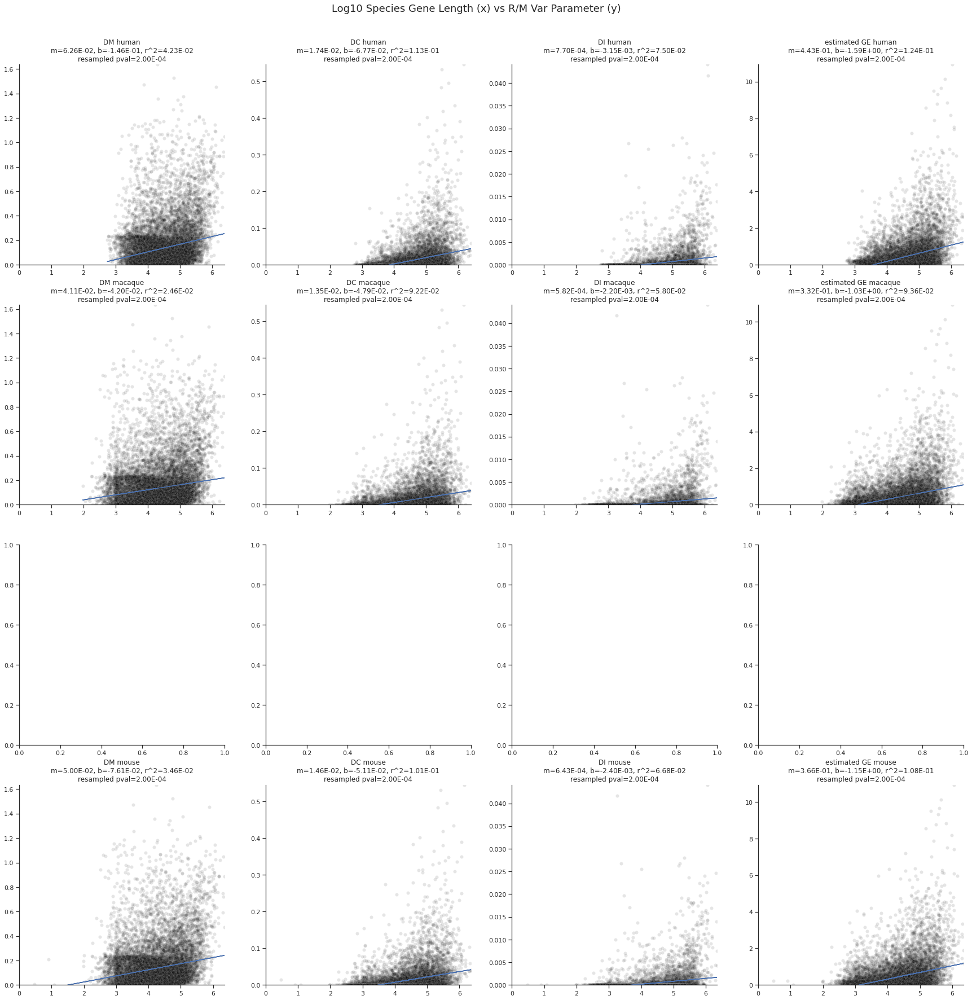

In [85]:
#Gene Size
intergenic_dfs=dict(zip(['human','macaque','mouse'],[h_length_intergenic,q_length_intergenic,m_length_intergenic]))
species_dict=dict(zip(adata.obs.species.cat.categories,list(range(pstore['discov_di'].shape[0]))))
params_dict=dict(zip(['DM','DC','DI','estimated GE'],[dm_diffs,dc_diffs,de_diffs,estimated_ge]))#,'real GE',real_ge

for contrast in species_contrasts.keys():
    fig, ax = plt.subplots(nrows=len(species_dict), ncols=len(params_dict),figsize=(30,30))
    for i,species in enumerate(species_dict.keys()):
        species_ind=species_dict[species]
        for j,paramname in enumerate(params_dict.keys()):
            if species not in intergenic_dfs.keys():
                continue
            params=params_dict[paramname]
            idf=intergenic_dfs[species]
            idf=idf.loc[idf['size']<1e7,:]
            param_contrast=params[species_contrasts[contrast][0]]-params[species_contrasts[contrast][1]]
            adata_genes=adata.var.index.isin(idf['gene'])
            genes=adata.var.index[adata_genes]
            idf.index=idf['gene']
            idf=idf.loc[genes,:]
            #x=idf.loc[:,'left'],idf.loc[:,'right']
            x=np.log10(idf.loc[:,['size']].min(1))
            y=param_contrast[:,adata_genes].var(0)#.abs().sum(0)#.var(0)
            #y=np.abs(param_contrast[:,adata_genes]).max(0)[0]
            seaborn.scatterplot(x,y,color='black',ax=ax[i][j],alpha=0.1)        
            a, b = np.polyfit(x, y, 1)
            model=np.poly1d([a,b])
            pval=resampling_slope_p_value(x.to_numpy(),y, num_iterations=num_iterations)#np.random.choice(y,len(y))
            ax[i][j].plot(x, a*x+b)
            r2=sklearn.metrics.r2_score(y,model(x))
            ax[i][j].set_xlim((0,x.max()))
            ax[i][j].set_ylim((0,y.max()))
            #seaborn.regplot((idf.loc[:,'left']+idf.loc[:,'right']+1),param_contrast[:,adata_genes].var(0).flatten(),color='black',ax=ax[i][j])        
            ax[i][j].set_title(paramname+" "+species+'\n'+
                               'm='+'%.2E'%Decimal(str(a))+', b='+'%.2E'%Decimal(str(b))+', r^2='+'%.2E'%Decimal(str(r2))+
                               '\n'+'resampled pval='+'%.2E'%Decimal(str(pval)),
                               y=1
                              )
            #ax[i][j].set_title('in median ='+str(np.median(comparison[:,gidx]))+'\nout median ='+str(np.median(comparison[:,ngidx])),y=0.8, fontsize=10)
    fig.suptitle('Log10 Species Gene Length (x) vs '+contrast+' Var Parameter (y)',y=0.93,fontsize=18)
    plt.show(fig)

In [ ]:
adata.X=adata.raw.X[:,adata.raw.var.index.isin(adata.var.index)]#.todense()
sc.pp.normalize_per_cell(adata)
sc.pp.log1p(adata)
sc.pp.scale(adata,max_value=10)

de=pyro.param('discov_di').cpu()
#de=(((pyro.param('discov_di')-antipode.species_bn.running_mean)/(antipode.species_bn.running_var**0.5+antipode.species_bn.eps))*antipode.species_bn.weight+antipode.species_bn.bias).cpu()
de_dfs=[]
for s in range(de.shape[0]):
    discov_di=[]
    discov_di_label=[]
    marker_coefs=[]
    marker_coefs_name=[]
    for t in range(de.shape[1]):
        if t not in adata.obs['antipode_cluster'].unique().astype(int):
            continue
        discov_di.append(adata.var.index[de[s,t,:].argsort()])
        discov_di.append(de[s,t,de[s,t,:].argsort()])
        discov_di_label.append(str(t)+'_'+'name')
        discov_di_label.append(str(t)+'_'+'coef')
    pd.DataFrame(discov_di,index=discov_di_label).T.to_csv(os.path.join('/home/mtschmitz/coefs','DE_coefs_'+adata.obs.species.cat.categories[s]+'.csv'))
    de_dfs.append(pd.DataFrame(discov_di,index=discov_di_label).T)

In [ ]:
for c in de_dfs[0].columns[de_dfs[0].columns.str.contains('name')]:
    genes=de_dfs[0][c][-3:]
    print(genes)
    print(c.replace('_name',''))
    try:
        sc.pl.violin(adata[adata.obs['antipode_cluster']==c.replace('_name',''),:],
                 groupby='species',keys=genes,use_raw=False)
    except:
        continue

In [ ]:
for c in de_dfs[0].columns[de_dfs[0].columns.str.contains('name')]:
    genes=de_dfs[0][c][:3]
    print(c.replace('_name',''))
    try:
        sc.pl.violin(adata[adata.obs['antipode_cluster']==c.replace('_name',''),:],
                 groupby='species',keys=genes,use_raw=False)
    except:
        continue

In [ ]:
c='209_name'
genes=de_dfs[0][c][-3:]
print(c.replace('_name',''))
sc.pl.violin(adata[adata.obs['antipode_cluster']==c.replace('_name',''),:],
         groupby='species',keys=genes,use_raw=False)


In [ ]:
de=pyro.param('discov_di').cpu()
de_dfs=[]
for s in range(de.shape[0]):
    discov_di=[]
    discov_di_label=[]
    marker_coefs=[]
    marker_coefs_name=[]
    for t in range(de.shape[1]):
        discov_di.append(adata.var.index[de[s,t,:].argsort()])
        discov_di.append(de[s,t,de[s,t,:].argsort()])
        discov_di_label.append(str(t)+'_'+'name')
        discov_di_label.append(str(t)+'_'+'coef')
    pd.DataFrame(discov_di,index=discov_di_label).T.to_csv(os.path.join('/home/mtschmitz/coefs','DE_coefs_'+adata.obs.species.cat.categories[s]+'.csv'))
    de_dfs.append(pd.DataFrame(discov_di,index=discov_di_label).T)

In [ ]:
seaborn.scatterplot(coefs.flatten(),de[0].flatten(),alpha=0.01)

In [ ]:
seaborn.scatterplot(pyro.param('s_inverse_dispersion').cpu().expand(de[0].shape).flatten(),de[0].flatten(),alpha=0.01)

In [ ]:
dc=pyro.param('discov_dc').cpu()
for s in range(dc.shape[0]):
    discov_dc=[]
    discov_dc_label=[]
    marker_coefs=[]
    marker_coefs_name=[]
    for t in range(dc.shape[1]):
        discov_dc.append(adata.var.index[dc[s,t,:].argsort()])
        discov_dc.append(dc[s,t,dc[s,t,:].argsort()])
        discov_dc_label.append(str(t)+'_'+'name')
        discov_dc_label.append(str(t)+'_'+'coef')
    pd.DataFrame(discov_dc,index=discov_dc_label).T.to_csv(os.path.join('/home/mtschmitz/coefs','DC_coefs_'+adata.obs.species.cat.categories[s]+'.csv'))


In [ ]:
dc=pyro.param('discov_dm').cpu()
for s in range(dc.shape[2]):
    discov_dc=[]
    discov_dc_label=[]
    marker_coefs=[]
    marker_coefs_name=[]
    for t in range(dc.shape[0]):
        module_names=np.array(range(dc.shape[1]))[dc[t,:,s].argsort()]
        discov_dc.append(['module_'+str(i) for i in module_names])
        discov_dc.append(dc[t,dc[t,:,s].argsort(),s])
        discov_dc_label.append(str(t)+'_'+'name')
        discov_dc_label.append(str(t)+'_'+'coef')
    pd.DataFrame(discov_dc,index=discov_dc_label).T.to_csv(os.path.join('/home/mtschmitz/coefs','DM_coefs_'+adata.obs.species.cat.categories[s]+'.csv'))

In [ ]:
marker_coefs=[]
marker_coefs_name=[]
for t in range(de.shape[1]):
    marker_coefs.append(adata.var.index[coefs[t,:].argsort()])
    marker_coefs.append(coefs[t,coefs[t,:].argsort()])
    marker_coefs_name.append(str(t)+'_'+'name')
    marker_coefs_name.append(str(t)+'_'+'coef')
marker_coefs=pd.DataFrame(marker_coefs,index=marker_coefs_name).T
marker_coefs.to_csv(os.path.join('/home/mtschmitz/coefs','marker_coefs.csv'))

In [ ]:
mod_coefs=pyro.param('z_decoder_weight').cpu()
marker_coefs=[]
marker_coefs_name=[]
for t in range(mod_coefs.shape[0]):
    marker_coefs.append(adata.var.index[mod_coefs[t,:].argsort()])
    marker_coefs.append(mod_coefs[t,mod_coefs[t,:].argsort()])
    marker_coefs_name.append(str(t)+'_'+'name')
    marker_coefs_name.append(str(t)+'_'+'coef')
mod_coef_table=pd.DataFrame(marker_coefs,index=marker_coefs_name).T
mod_coef_table.to_csv(os.path.join('/home/mtschmitz/coefs','module_coefs.csv'))

In [ ]:
locs=pyro.param('locs').cpu()
pd.DataFrame(locs,index=['cluster_'+str(i) for i in range(locs.shape[0])],columns=['module_'+str(i) for i in  range(locs.shape[1])])

In [ ]:
marker_coefs=[]
marker_coefs_name=[]
for t in range(locs.shape[0]):
    mod_names=np.array(range(locs.shape[1]))[locs[t,:].argsort()]
    marker_coefs.append(['module_'+str(i) for i in mod_names])
    marker_coefs.append(locs[t,locs[t,:].argsort()])
    marker_coefs_name.append(str(t)+'_'+'name')
    marker_coefs_name.append(str(t)+'_'+'coef')
pd.DataFrame(marker_coefs,index=marker_coefs_name).T.to_csv(os.path.join('/home/mtschmitz/coefs','anc_loc_coefs.csv'))

In [ ]:
pd.DataFrame(marker_coefs,index=marker_coefs_name).T

In [87]:
import gseapy as gp
import re

gp.get_library_name() 

In [88]:
weight_tab=pd.DataFrame(pstore['z_decoder_weight'].T,index=adata.var.index)

In [ ]:
overall = gp.prerank(rnk=weight_tab, gene_sets='GO_Biological_Process_2023',#gene_sets=['KEGG_2019_Human','GWAS_Catalog_2023'],
                     threads=8,
                     permutation_num=500,no_plot=True, # reduce number to speed up testing
                     outdir='test/prerank_report_kegg', format='png', seed=6,verbose=True)

In [ ]:
pre_res={}
for x in tqdm.tqdm(weight_tab.columns):
    pre_res[x] = gp.prerank(rnk=weight_tab[x], gene_sets='GO_Biological_Process_2023',#gene_sets=['KEGG_2019_Human','GWAS_Catalog_2023'],
                         threads=1,
                         permutation_num=1000,no_plot=True, # reduce number to speed up testing
                         outdir='test/prerank_report_kegg', format='png', seed=666)

In [ ]:
dfs=[]
pval_name='FDR q-val'
for x in pre_res.keys():
    enrichDF=pre_res[x].res2d.loc[:,[pval_name,'Term']]
    enrichDF['celltype']=x
    enrichDF.index=enrichDF['Term']
    enrichDF=enrichDF.loc[enrichDF[pval_name]<.03,:]
    enrichDF=enrichDF.loc[~np.isnan(enrichDF[pval_name].values.astype(float)),:]
    enrichDF=enrichDF.iloc[0:min(enrichDF.shape[0],2),:]
    dfs.append(enrichDF)
catMat=pd.concat(dfs,axis=1, join='outer')
fdrMat=catMat.loc[:,catMat.columns.str.contains(pval_name)]
fdrMat.columns=list(pre_res.keys())
#print(fdrMat)
seaborn.set(style="white")
seaborn.set(font_scale=3)
plt.figure(figsize = (30,20))
seaborn.heatmap(-np.log10(fdrMat+.001),cmap='RdYlBu_r',yticklabels=True, linecolor='white',square=True,)
plt.show()

In [ ]:
def gex_output(x,m,b):
    return((x@m+b))

In [4]:
adata.write_h5ad('/home/matthew.schmitz/Matthew/1.9.1.6_Devanalysisinprogress.h5ad')
